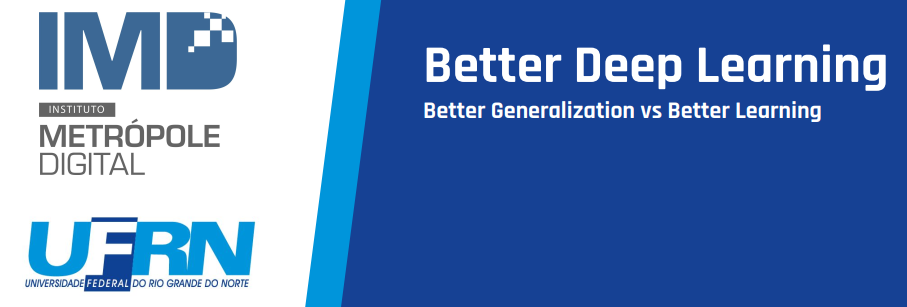

# Grupo:


*   CARLOS FREDERICO CARVALHEIRA MELLO;
*   CARMEM STEFANIE DA SILVA CAVALCANTE;
*   EWERTON LEANDRO DE SOUSA.



# Tópicos 

## Better Generalization:

* Force small weight with weight constraint;
* Halt training at the right time with early stopping.

## Better Learning
* Fix vanishing gradiente with relu;







---



#1.0. Importação de bibliotecas

In [ ]:
!pip install mlxtend==0.17.3

     |████████████████████████████████| 1.3 MB 8.0 MB/s 
  Attempting uninstall: mlxtend
    Found existing installation: mlxtend 0.14.0
    Uninstalling mlxtend-0.14.0:
      Successfully uninstalled mlxtend-0.14.0


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import datetime
import pytz
import sklearn
import sklearn.datasets
import scipy.io
import os
import time
from sklearn.datasets import make_moons
from sklearn.datasets import load_boston
from mlxtend.plotting import plot_decision_regions

from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Sequential

from tensorflow.keras.constraints import unit_norm

from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import Dropout

from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import load_model

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from keras.wrappers.scikit_learn import KerasRegressor


%matplotlib inline
plt.rcParams['figure.figsize'] = (7.0, 3.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
# Clear any logs from previous runs
!rm -rf logs

In [ ]:
print('Versão do TensorFlow', tf.__version__)

Versão do TensorFlow 2.5.0


#2.0. Importação do Dataset

##2.1. Dataset Circle

In [ ]:
def load_dataset_circles():
    np.random.seed(1)
    train_X, train_Y = sklearn.datasets.make_circles(n_samples=300, noise=.05)
    np.random.seed(2)
    test_X, test_Y = sklearn.datasets.make_circles(n_samples=100, noise=.05)
    # Visualize the data
    plt.scatter(train_X[:, 0], train_X[:, 1], c=train_Y.ravel(), s=40, cmap=plt.cm.Spectral);
    train_X = train_X
    train_Y = train_Y.reshape((train_Y.shape[0],1))
    test_X = test_X
    test_Y = test_Y.reshape((test_Y.shape[0]),1)
    return train_X, train_Y, test_X, test_Y

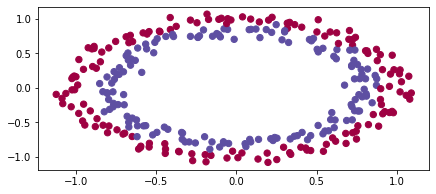

In [ ]:
train_x,train_y,test_x,test_y = load_dataset_circles()

In [ ]:
print("Shape\nTrain_x: {0} \t Train_y: {1}\nTest_x: {2} \t Test_y: {3}\n".format(train_x.shape,train_y.shape,test_x.shape,test_y.shape))

Shape
Train_x: (300, 2) 	 Train_y: (300, 1)
Test_x: (100, 2) 	 Test_y: (100, 1)



##2.2. Dataset Moons

In [ ]:
def load_dataset_moons():
    train_X, train_Y = sklearn.datasets.make_moons(n_samples=300, noise=.05, random_state=1)
    test_X, test_Y = sklearn.datasets.make_moons(n_samples=100, noise=.05, random_state=2)

    # Visualize the data
    plt.scatter(train_X[:, 0], train_X[:, 1], c=train_Y.ravel(), s=40, cmap=plt.cm.Spectral);
    train_X = train_X
    train_Y = train_Y.reshape((train_Y.shape[0],1))
    test_X = test_X
    test_Y = test_Y.reshape((test_Y.shape[0]),1)
    
    return train_X, train_Y, test_X, test_Y

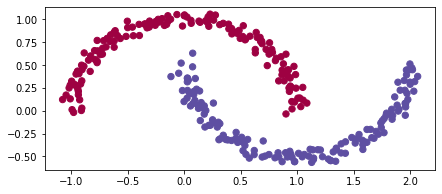

In [ ]:
train_x,train_y,test_x,test_y = load_dataset_moons()

In [ ]:
print("Shape\nTrain_x: {0} \t Train_y: {1}\nTest_x: {2} \t Test_y: {3}\n".format(train_x.shape,train_y.shape,test_x.shape,test_y.shape))

Shape
Train_x: (300, 2) 	 Train_y: (300, 1)
Test_x: (100, 2) 	 Test_y: (100, 1)





---



# 3.0. Force small weight with weight constraint (Ewerton)

## Case Study 
[Extensions]

1. Weight constraints can improve generalization when used in
conjunction with other regularization methods, like L2 or
Dropout.

2. Report Weight Norm: update the example to calculate the
magnitude of the unit weights and demonstrate that the
constraint indeed made the magnitude smaller.

3. Constrain Output Layer: update the example to add a constraint
to the output layer of the model and compare the results.

4. Constrain Bias: update the example to add a constraint to the
bias weight and compare the results.

## Callbaks

In [ ]:
class MyCustomCallback(tf.keras.callbacks.Callback):

  def on_train_begin(self, batch, logs=None):
    self.begins = time.time()
    print('Training: begins at {}'.format(datetime.datetime.now(pytz.timezone('America/Fortaleza')).strftime("%a, %d %b %Y %H:%M:%S")))

  def on_train_end(self, logs=None):
    print('Training: ends at {}'.format(datetime.datetime.now(pytz.timezone('America/Fortaleza')).strftime("%a, %d %b %Y %H:%M:%S")))
    print('Duration: {:.2f} seconds'.format(time.time() - self.begins))    

In [ ]:
# callbacks tensorboard
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=100)

## Treino

In [ ]:
def fit(model, train_x, train_y, test_x, test_y):
  # fit model
  return model.fit(train_x, train_y, validation_data=(test_x, test_y), epochs=4000, verbose=0, callbacks=[MyCustomCallback(),tensorboard_callback])


## Avaliação

In [ ]:
def index_menor(lista):
  min_value = min(lista)
  return lista.index(min_value)

In [ ]:
def index_menor(lista, valor):
  pos = -1
  for i in range(len(lista)):
      # Check if items matches the given element
      if lista[i] < valor:
          pos = i
          break

  return pos

In [ ]:
def index_maior(lista):
  max_value = max(lista)
  return lista.index(max_value)

In [ ]:
def index_maior(lista, valor):
  pos = -1
  for i in range(len(lista)):
      # Check if items matches the given element
      if lista[i] > valor:
          pos = i
          break

  return pos

In [ ]:
def evaluate(model, history, train_x, train_y, test_x, test_y, max_epochs):
  # evaluate the model
  _, train_acc = model.evaluate(train_x, train_y, verbose=0)
  _, test_acc = model.evaluate(test_x, test_y, verbose=0)
  print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

  plt.style.use("ggplot")
  # plot loss learning curves
  fig = plt.figure()
  ax = fig.add_subplot(111)
  ax.set_xlim([-100, max_epochs + 100])
  ax.set_ylim([-0.05, 0.7])
  post = index_menor(history.history['loss'], 0.005)
  valt = history.history['loss'][post]
  pose = index_menor(history.history['val_loss'], 0.005)
  vale = history.history['val_loss'][pose]
  plt.title('Cross-Entropy Loss', pad=-40)
  plt.plot(history.history['loss'][:max_epochs], label='train')
  plt.plot(history.history['val_loss'][:max_epochs], label='test')
  if post != -1:
    ax.annotate('Epoch train: ' + str(post), xy=(post, valt), xytext=(post + 50, valt + 0.1 ), arrowprops=dict(facecolor=(1,0,0,0.5), shrink=0.05))
  if pose != -1:
    ax.annotate('Epoch test: ' + str(pose), xy=(pose, vale), xytext=(pose + 54, vale + 0.15 ), arrowprops=dict(facecolor=(0,0,1,0.5), shrink=0.05))
  plt.legend()
  plt.tight_layout()
  plt.show()


  # plot accuracy learning curves
  fig = plt.figure()
  ax = fig.add_subplot(111)
  ax.set_xlim([-100, max_epochs + 100])
  ax.set_ylim([0.8, 1.05])
  post = index_maior(history.history['accuracy'], 0.9999)
  valt = history.history['accuracy'][post]
  pose = index_maior(history.history['val_accuracy'], 0.9999)
  vale = history.history['val_accuracy'][pose]
  plt.title('Accuracy', pad=-40)
  plt.plot(history.history['accuracy'][:max_epochs], label='train')
  plt.plot(history.history['val_accuracy'][:max_epochs], label='test')
  if post != -1:
    ax.annotate('Epoch train: ' + str(post), xy=(post, valt), xytext=(post + 50, valt - 0.05), arrowprops=dict(facecolor=(1,0,0,0.5), shrink=0.05))
  if pose != -1:
    ax.annotate('Epoch test: ' + str(pose), xy=(pose, vale), xytext=(pose + 55, vale - 0.10 ), arrowprops=dict(facecolor=(0,0,1,0.5), shrink=0.05))
  plt.legend()
  plt.tight_layout()
  plt.show()

  # plot weights and bias
  plt.title('Distribuição dos pesos', pad=-40)
  plt.hist(model.layers[0].get_weights()[0][0], label='L1 Weights 1', bins=20, alpha=0.5)
  plt.hist(model.layers[0].get_weights()[0][1], label='L1 Weights 2', bins=20, alpha=0.5)
  plt.hist(model.layers[0].get_weights()[1], label='L1 Bias', bins=20, alpha=0.5)
  plt.hist(model.layers[1].get_weights()[0], label='L2 Weights', bins=20, alpha=0.5)
  plt.hist(model.layers[1].get_weights()[1], label='L2 Bias', bins=20, alpha=0.5)
  plt.legend()
  plt.tight_layout()
  plt.show()

  plt.style.use('default')
  fig = plt.figure()
  ax = fig.add_subplot(111)
  ax.set_xlim([-10, 10])
  plot_decision_regions(test_x,test_y.squeeze(), clf=model,zoom_factor=2.0)
  plt.show()

##3.1. Modelo sem constraints

In [ ]:
# define model
model_without = Sequential()
model_without.add(Dense(500, input_dim=2, activation='relu'))
model_without.add(Dense(1, activation='sigmoid'))
model_without.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
model_without.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 500)               1500      
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 501       
Total params: 2,001
Trainable params: 2,001
Non-trainable params: 0
_________________________________________________________________


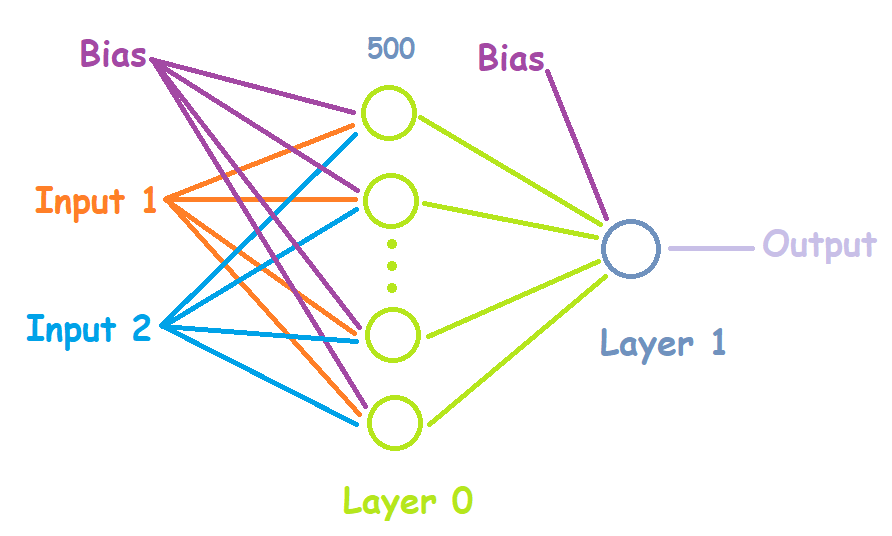

In [ ]:
hist_without = fit(model_without, train_x, train_y, test_x, test_y)

Training: begins at Tue, 27 Jul 2021 21:05:29
Training: ends at Tue, 27 Jul 2021 21:08:05
Duration: 155.83 seconds


-- Modelo sem Constraints --

Train: 1.000, Test: 1.000


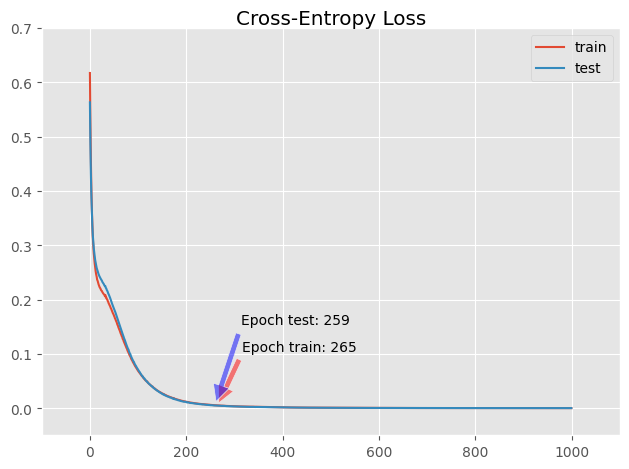

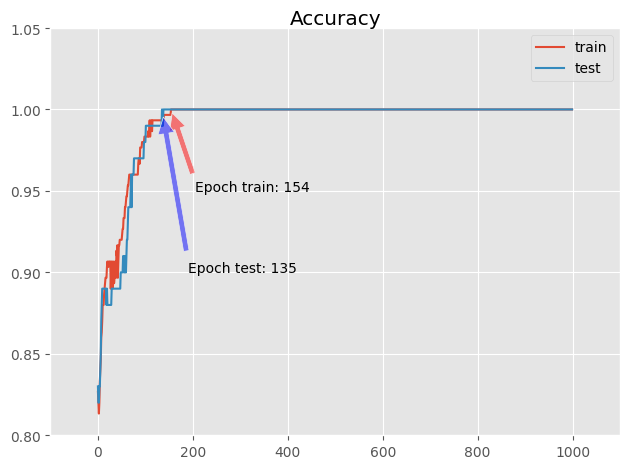

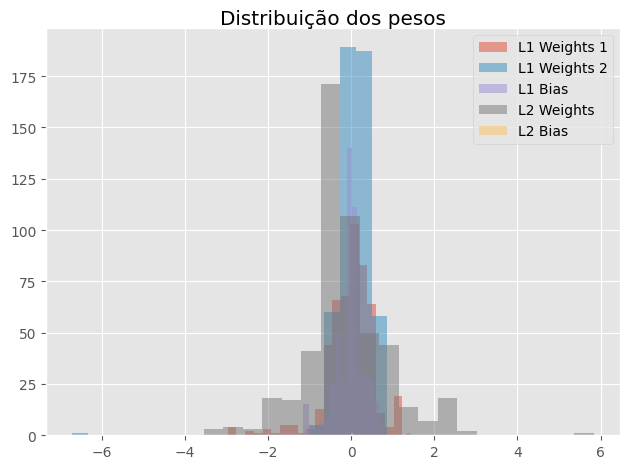

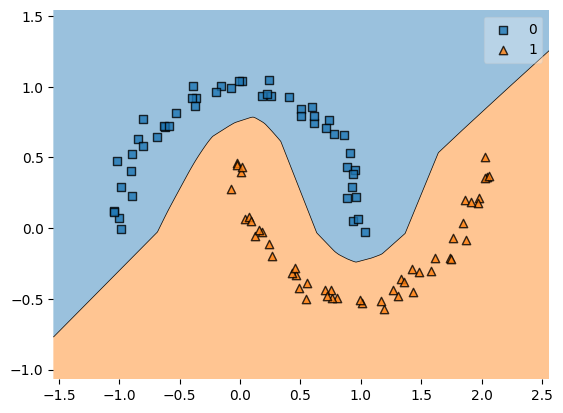

In [ ]:
print("-- Modelo sem Constraints --\n")
evaluate(model_without, hist_without, train_x, train_y, test_x, test_y, 1000)

In [ ]:
# Start TensorBoard within the notebook using magics
%tensorboard --logdir logs

##3.2.1. Modelo com constrints Unit_Norm

In [ ]:
# define model
model_with_unit_norm = Sequential()
model_with_unit_norm.add(Dense(500, input_dim=2, activation='relu', kernel_constraint=unit_norm()))
model_with_unit_norm.add(Dense(1, activation='sigmoid'))
model_with_unit_norm.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
hist_unit_norm = fit(model_with_unit_norm, train_x, train_y, test_x, test_y)

Training: begins at Tue, 27 Jul 2021 21:28:52
Training: ends at Tue, 27 Jul 2021 21:31:27
Duration: 155.14 seconds


-- Modelo com Constraints --

Train: 1.000, Test: 1.000


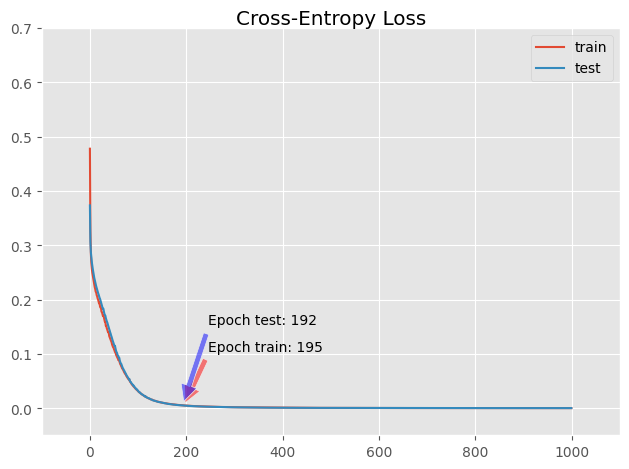

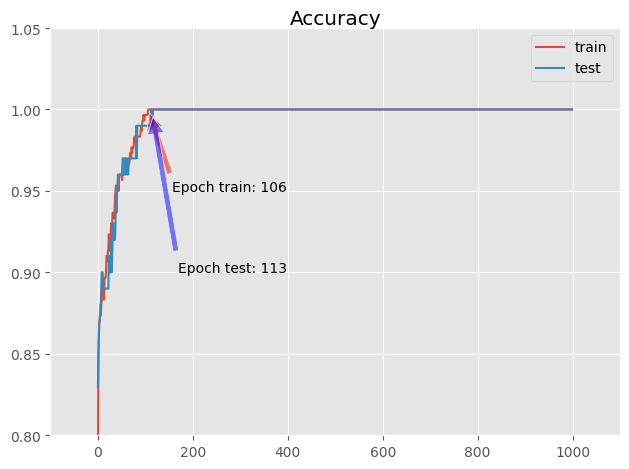

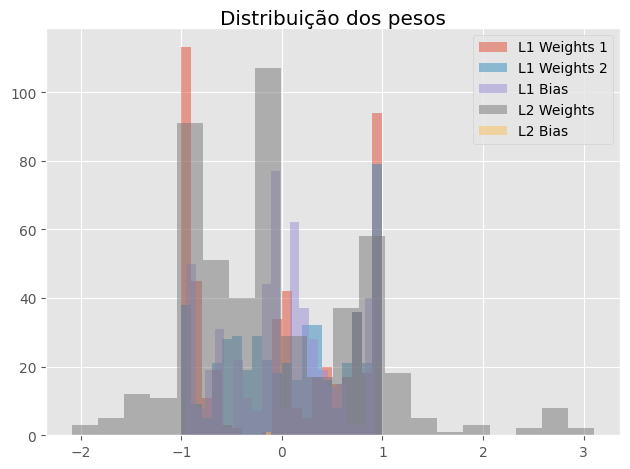

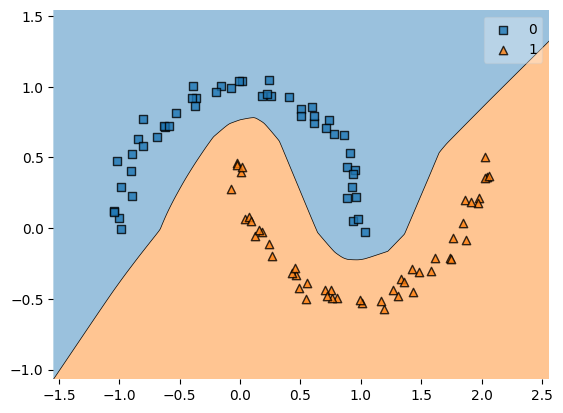

In [ ]:
print("-- Modelo com Constraints --\n")
evaluate(model_with_unit_norm, hist_unit_norm, train_x, train_y, test_x, test_y, 1000)

In [ ]:
# Start TensorBoard within the notebook using magics
%tensorboard --logdir logs

##3.2.2. Weight constraints and L2

In [ ]:
# define model
model_with_const_l2 = Sequential()
model_with_const_l2.add(Dense(500, input_dim=2, activation='relu', kernel_constraint=unit_norm(), kernel_regularizer=l2(0.001)))
model_with_const_l2.add(Dense(1, activation='sigmoid'))
model_with_const_l2.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
hist_const_l2 = fit(model_with_const_l2, train_x, train_y, test_x, test_y)

Training: begins at Tue, 27 Jul 2021 21:38:47
Training: ends at Tue, 27 Jul 2021 21:41:22
Duration: 154.06 seconds


-- Modelo com Constraints e L2 --

Train: 1.000, Test: 1.000


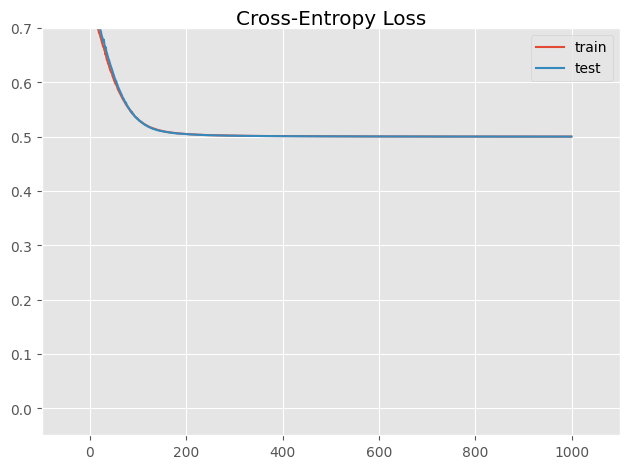

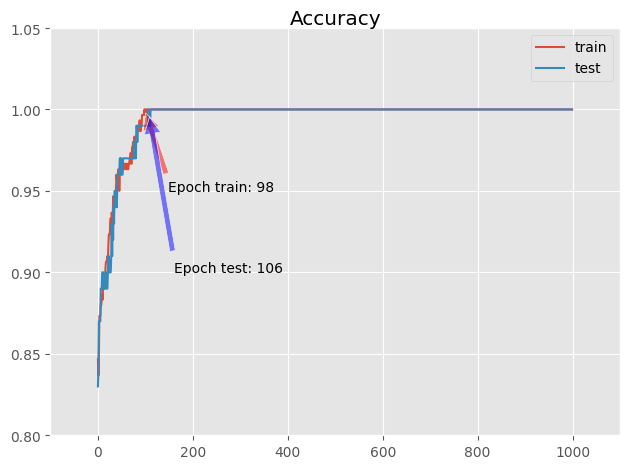

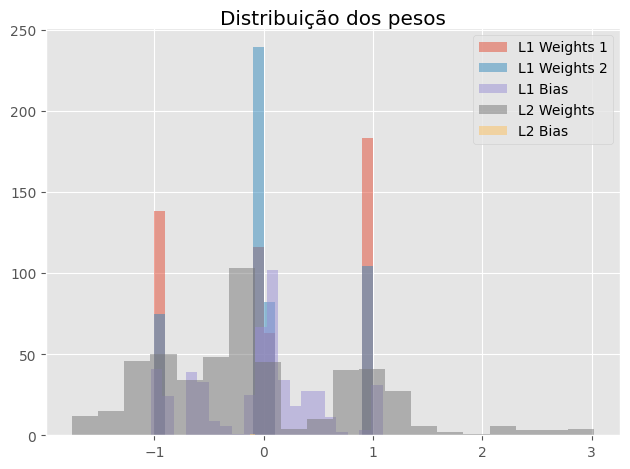

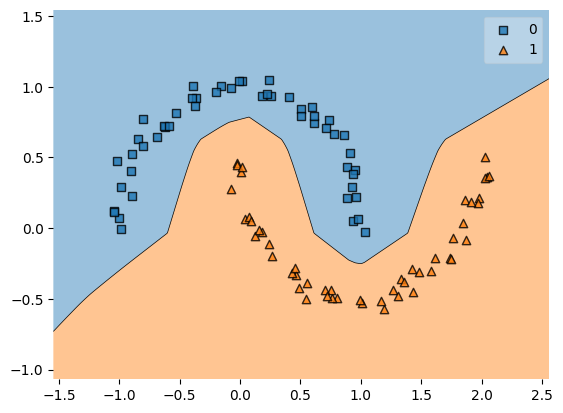

In [ ]:
print("-- Modelo com Constraints e L2 --\n")
evaluate(model_with_const_l2, hist_const_l2, train_x, train_y, test_x, test_y, 1000)

In [ ]:
# Start TensorBoard within the notebook using magics
%tensorboard --logdir logs

##3.2.3. Weight constraints and Dropout



In [ ]:
# define model
model_with_const_Dropout = Sequential()
model_with_const_Dropout.add(Dense(500, input_dim=2, activation='relu', kernel_constraint=unit_norm()))
model_with_const_Dropout.add(Dropout(0.4))
model_with_const_Dropout.add(Dense(1, activation='sigmoid'))
model_with_const_Dropout.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
hist_const_Dropout = fit(model_with_const_Dropout, train_x, train_y, test_x, test_y)

Training: begins at Tue, 27 Jul 2021 21:49:19
Training: ends at Tue, 27 Jul 2021 21:52:06
Duration: 167.06 seconds


-- Modelo com Constraints e Dropout (40%) --

Train: 1.000, Test: 1.000


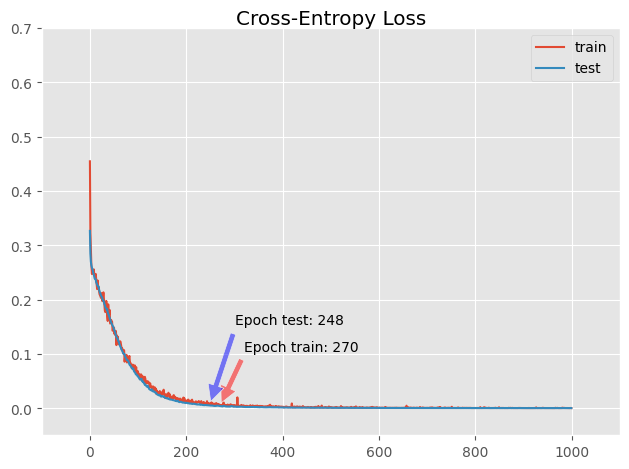

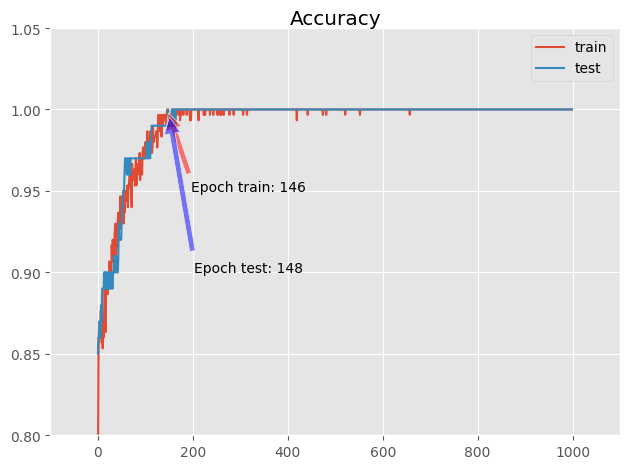

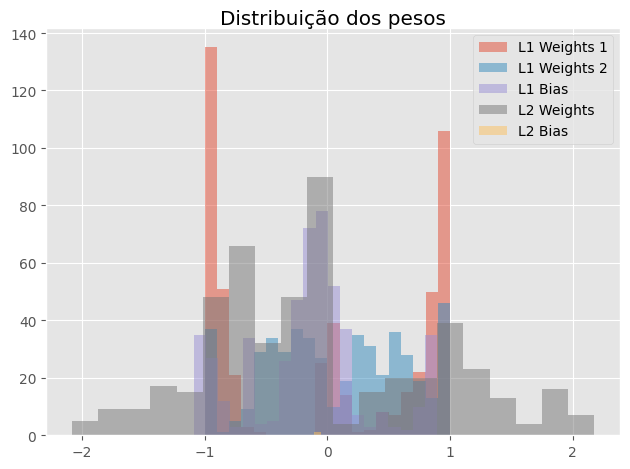

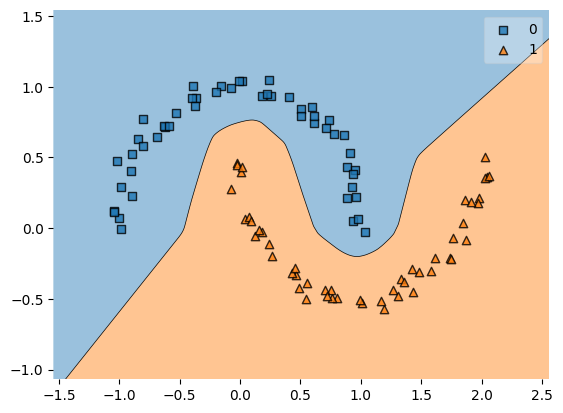

In [ ]:
print("-- Modelo com Constraints e Dropout (40%) --\n")
evaluate(model_with_const_Dropout, hist_const_Dropout, train_x, train_y, test_x, test_y, 1000)

##3.2.4. Weight constraints with L2 e Dropout

In [ ]:
# define model
model_with_const_Dropout_L2 = Sequential()
model_with_const_Dropout_L2.add(Dense(500, input_dim=2, activation='relu', kernel_constraint=unit_norm(), kernel_regularizer=l2(0.001)))
model_with_const_Dropout_L2.add(Dropout(0.4))
model_with_const_Dropout_L2.add(Dense(1, activation='sigmoid'))
model_with_const_Dropout_L2.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
hist_const_Dropout_L2 = fit(model_with_const_Dropout_L2, train_x, train_y, test_x, test_y)

Training: begins at Tue, 27 Jul 2021 22:02:37
Training: ends at Tue, 27 Jul 2021 22:05:24
Duration: 166.92 seconds


-- Modelo com Constraints, Dropout (40%) e L2 --

Train: 1.000, Test: 1.000


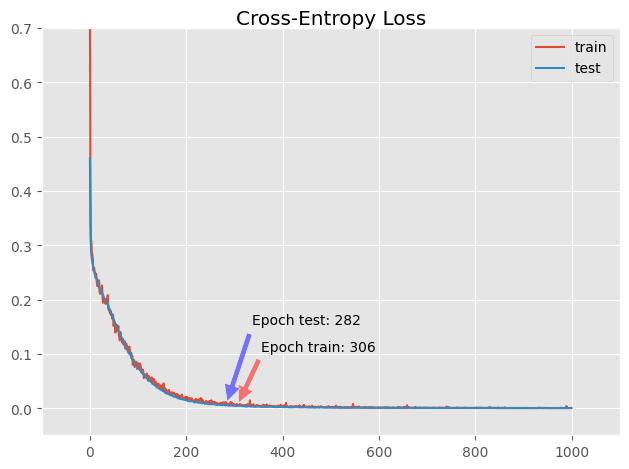

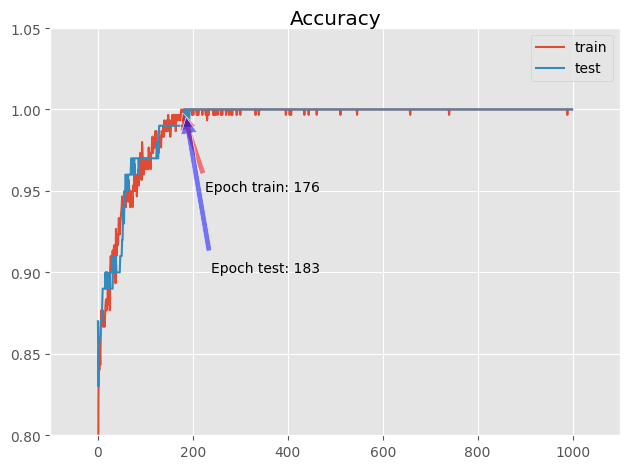

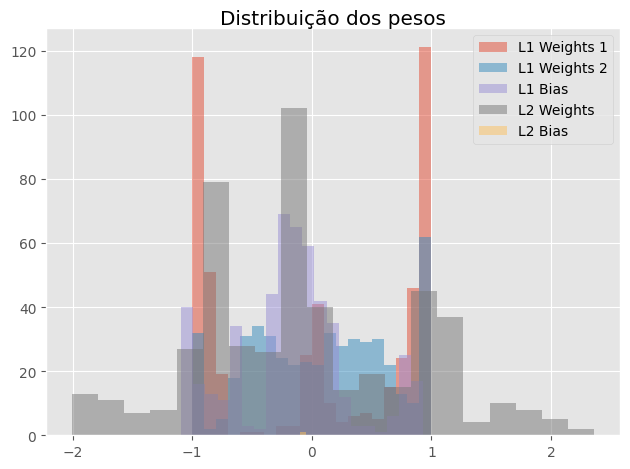

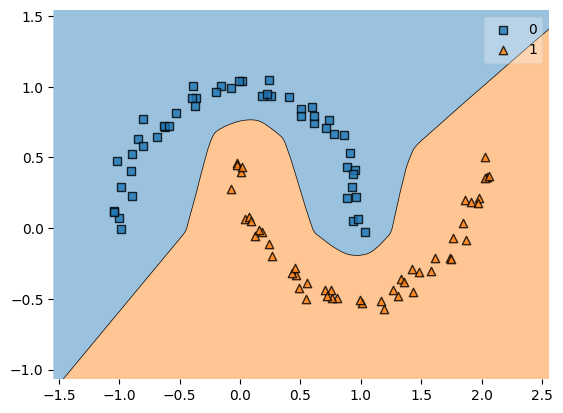

In [ ]:
print("-- Modelo com Constraints, Dropout (40%) e L2 --\n")
evaluate(model_with_const_Dropout_L2, hist_const_Dropout_L2, train_x, train_y, test_x, test_y, 1000)

##3.3.1. Constrain Output Layer

In [ ]:
# define model
model_with_const_output = Sequential()
model_with_const_output.add(Dense(500, input_dim=2, activation='relu' ))
model_with_const_output.add(Dense(1, activation='sigmoid', kernel_constraint=unit_norm()))
model_with_const_output.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
hist_const_output = fit(model_with_const_output, train_x, train_y, test_x, test_y)

Training: begins at Tue, 27 Jul 2021 22:23:42
Training: ends at Tue, 27 Jul 2021 22:26:21
Duration: 159.09 seconds


In [ ]:
model_with_const_output.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_14 (Dense)             (None, 500)               1500      
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 501       
Total params: 2,001
Trainable params: 2,001
Non-trainable params: 0
_________________________________________________________________


-- Modelo com Constraints Output --

Train: 1.000, Test: 1.000


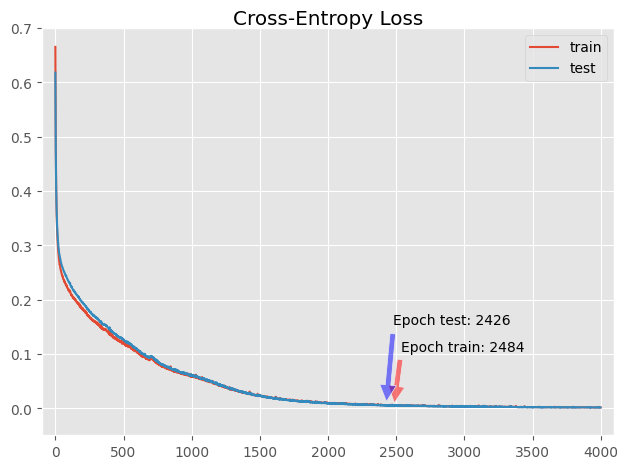

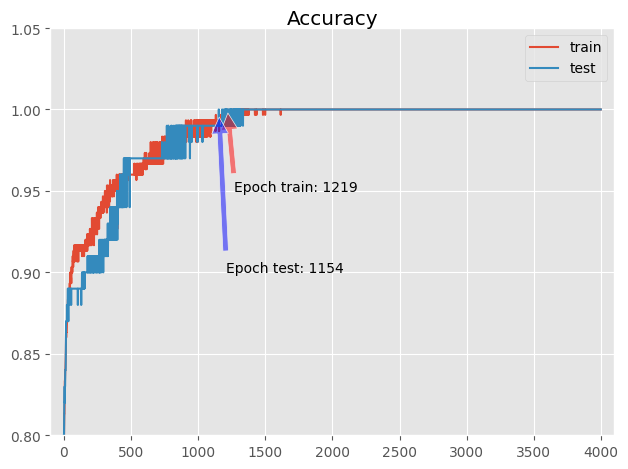

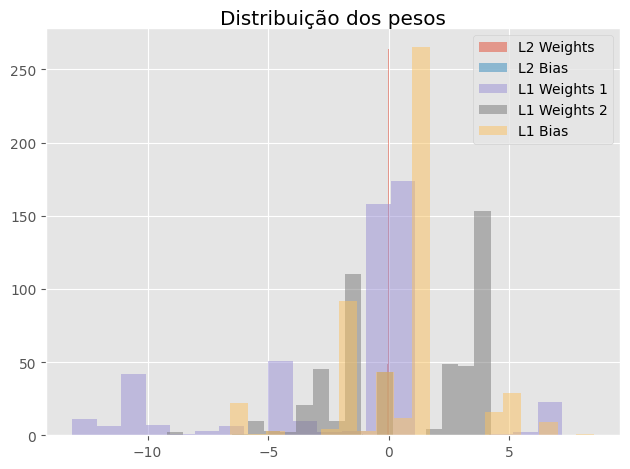

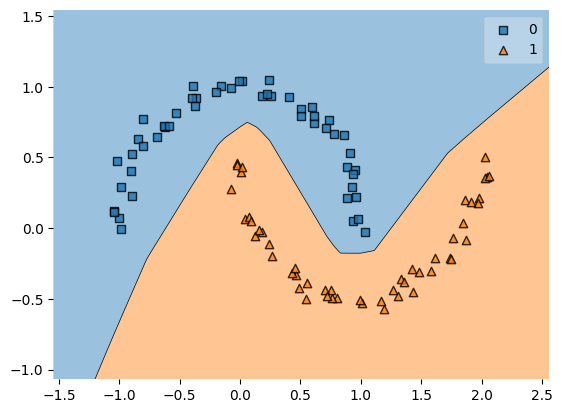

In [ ]:
print("-- Modelo com Constraints Output --\n")
evaluate(model_with_const_output, hist_const_output, train_x, train_y, test_x, test_y, 4000)

##3.3.2. Constrain Input and Output Layer

In [ ]:
# define model
model_with_const_input_output = Sequential()
model_with_const_input_output.add(Dense(500, input_dim=2, activation='relu', kernel_constraint=unit_norm()))
#model_with_const_input_output.add(Dropout(0.4))
model_with_const_input_output.add(Dense(1, activation='sigmoid', kernel_constraint=unit_norm()))
model_with_const_input_output.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
hist_const_input_output = fit(model_with_const_input_output, train_x, train_y, test_x, test_y)

Training: begins at Tue, 27 Jul 2021 22:33:54
Training: ends at Tue, 27 Jul 2021 22:36:35
Duration: 161.10 seconds


-- Modelo com Constraints Input and Output --

Train: 0.983, Test: 0.970


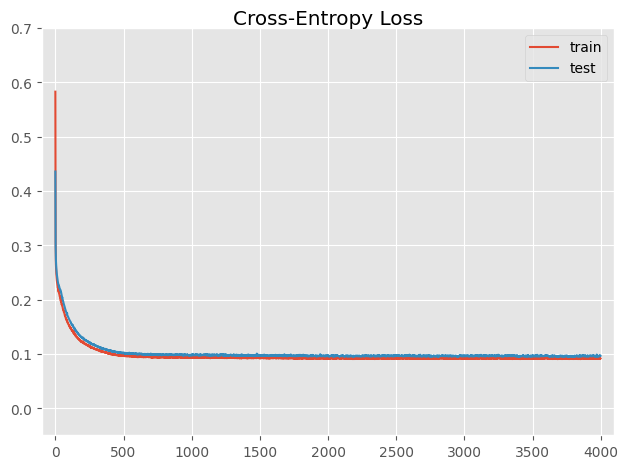

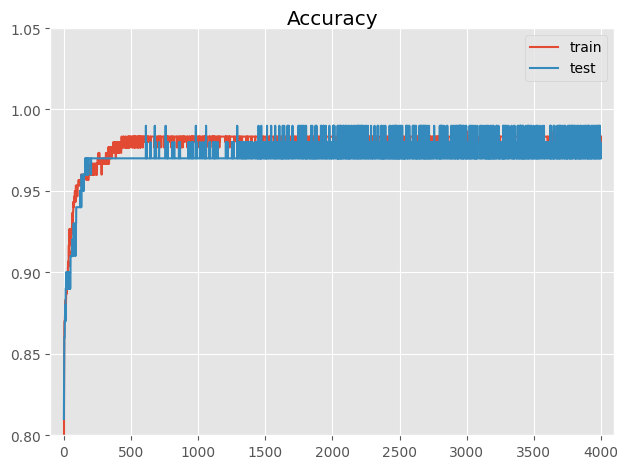

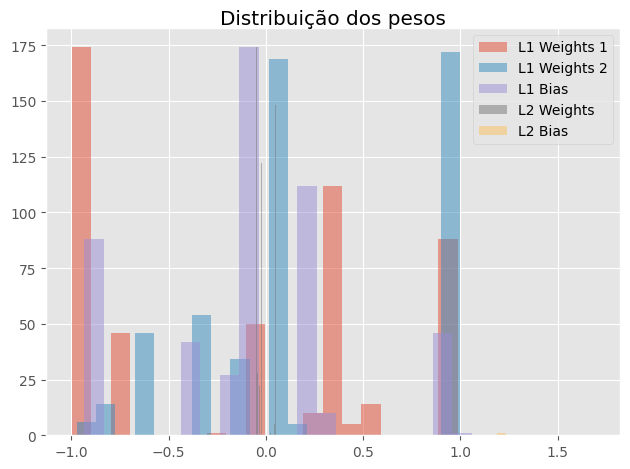

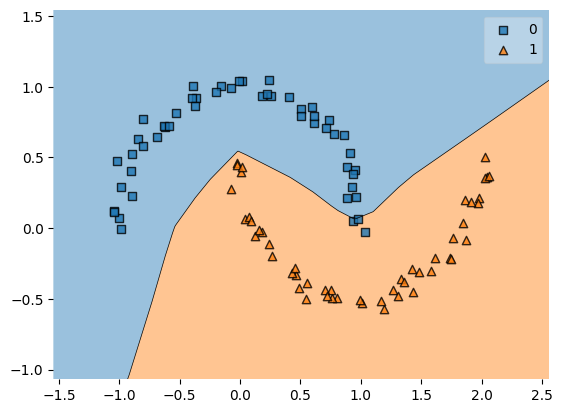

In [ ]:
print("-- Modelo com Constraints Input and Output --\n")
evaluate(model_with_const_input_output, hist_const_input_output, train_x, train_y, test_x, test_y, 4000)

##3.4.1 Constrain Bias

In [ ]:
# define model
model_with_const_bias = Sequential()
model_with_const_bias.add(Dense(500, input_dim=2, activation='relu', bias_constraint=unit_norm()))
#model_with_const_bias.add(Dropout(0.4))
model_with_const_bias.add(Dense(1, activation='sigmoid'))
model_with_const_bias.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
hist_const_bias = fit(model_with_const_bias, train_x, train_y, test_x, test_y)

Training: begins at Tue, 27 Jul 2021 22:39:53
Training: ends at Tue, 27 Jul 2021 22:42:33
Duration: 160.03 seconds


-- Modelo com Constraints Bias --

Train: 1.000, Test: 1.000


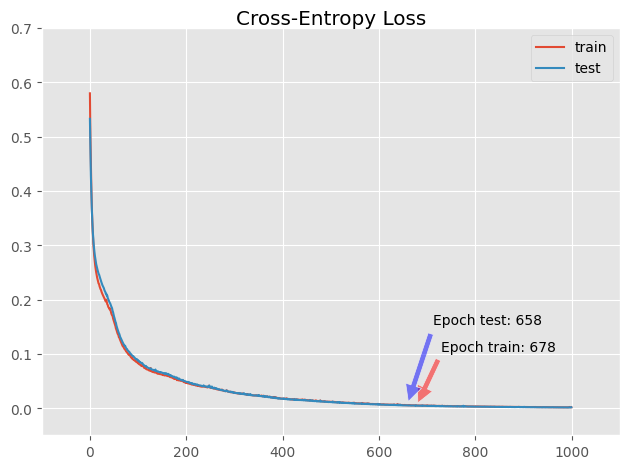

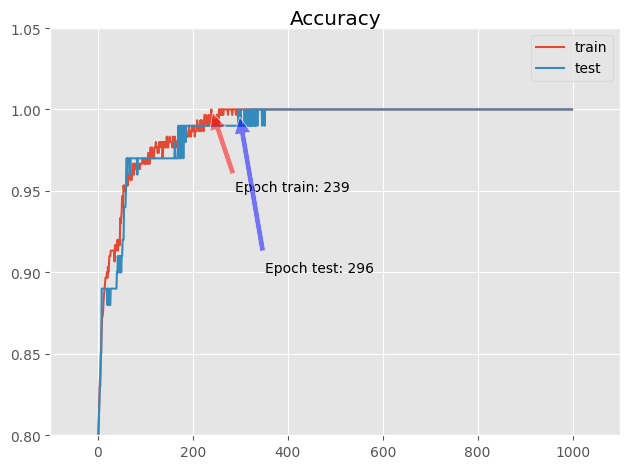

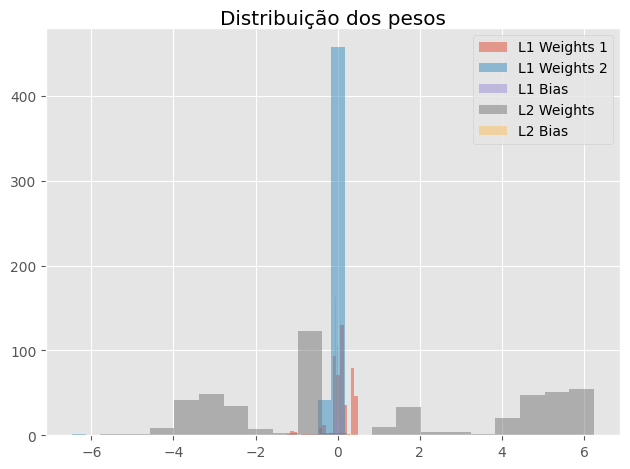

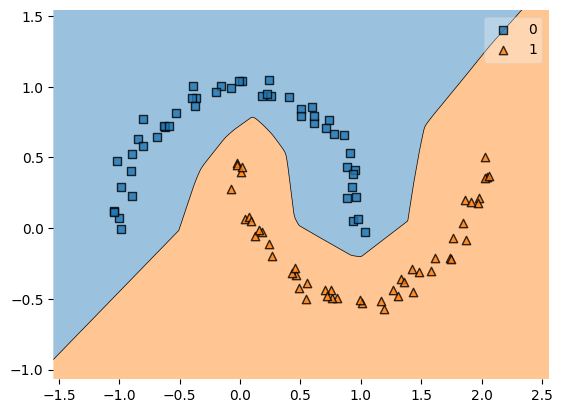

In [ ]:
print("-- Modelo com Constraints Bias --\n")
evaluate(model_with_const_bias, hist_const_bias, train_x, train_y, test_x, test_y, 1000)

##3.4.2 Constrain Weights and Bias

In [ ]:
# define model
model_with_const_weights_bias = Sequential()
model_with_const_weights_bias.add(Dense(500, input_dim=2, activation='relu', kernel_constraint=unit_norm(), bias_constraint=unit_norm()))
#model_with_const_weights_bias.add(Dropout(0.4))
model_with_const_weights_bias.add(Dense(1, activation='sigmoid'))
model_with_const_weights_bias.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
hist_const_weights_bias = fit(model_with_const_weights_bias, train_x, train_y, test_x, test_y)

Training: begins at Tue, 27 Jul 2021 22:48:14
Training: ends at Tue, 27 Jul 2021 22:50:50
Duration: 155.64 seconds


-- Modelo com Constraints, Dropout (40%) e L2 --

Train: 1.000, Test: 1.000


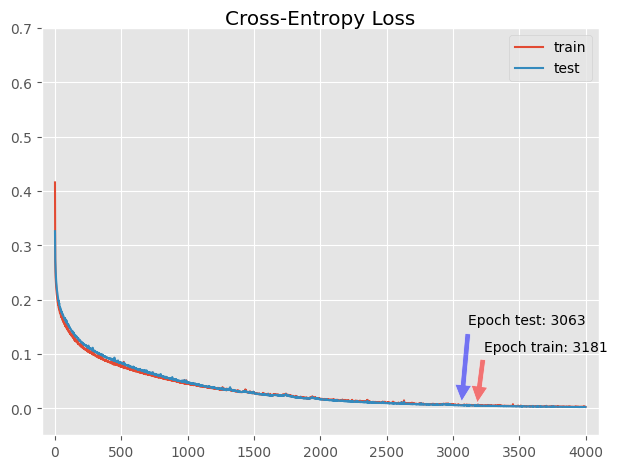

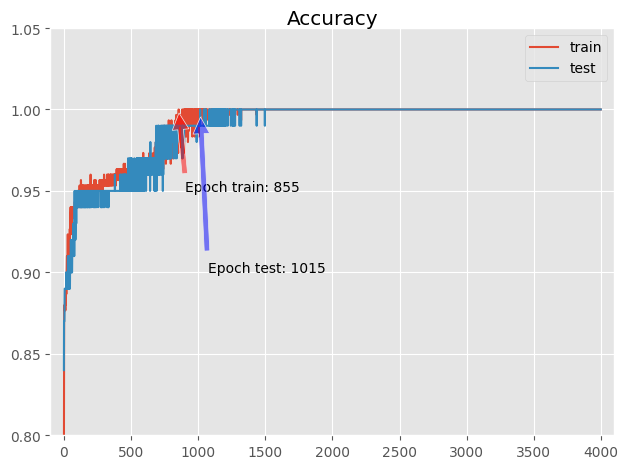

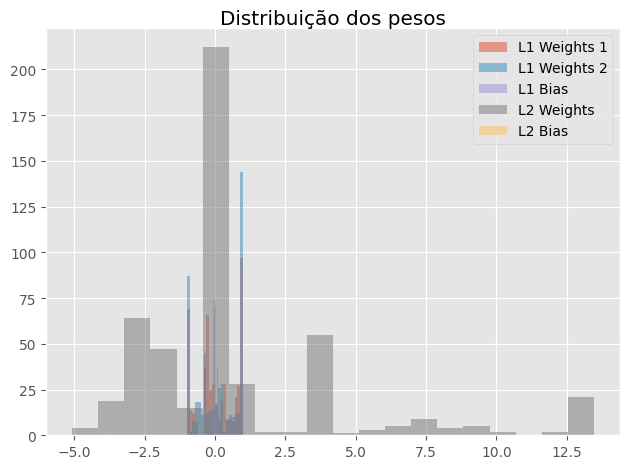

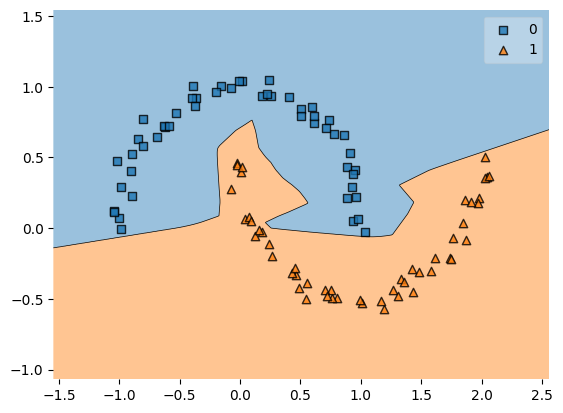

In [ ]:
print("-- Modelo com Constraints, Dropout (40%) e L2 --\n")
evaluate(model_with_const_weights_bias, hist_const_weights_bias, train_x, train_y, test_x, test_y, 4000)

##3.5.1. Resultados

Foi utilizado um modelo relativamente grande com 501 neurônios que foi treinado excesivamento por 4.000 época, o que gerou rede com overfitting.


## Sem constraints

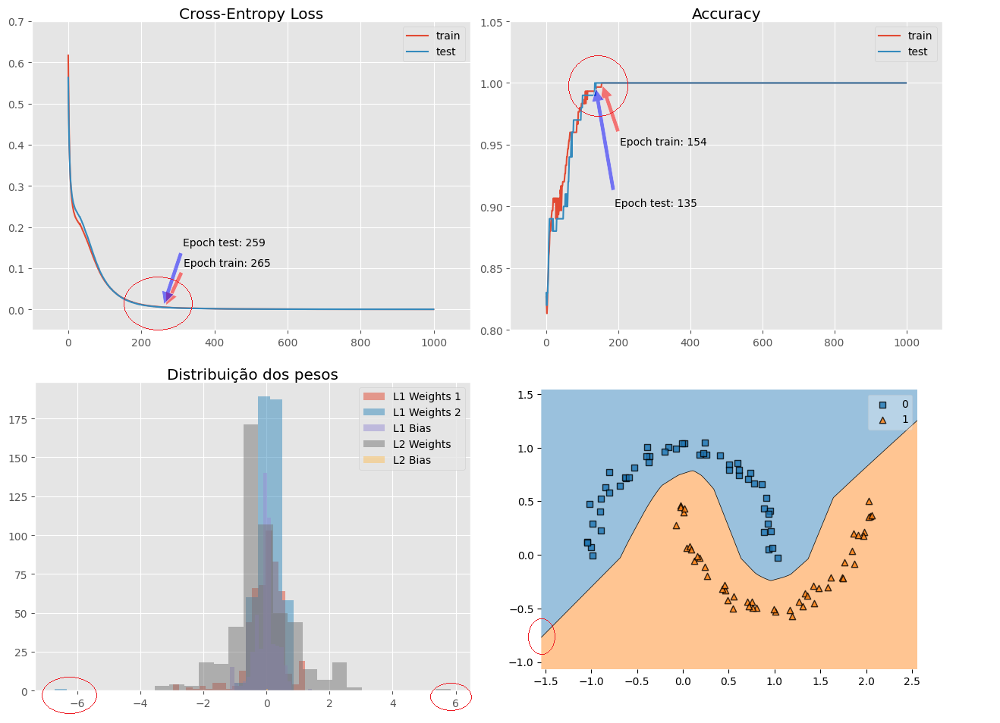

## Com contraints somente nos pesos da camada de entrada
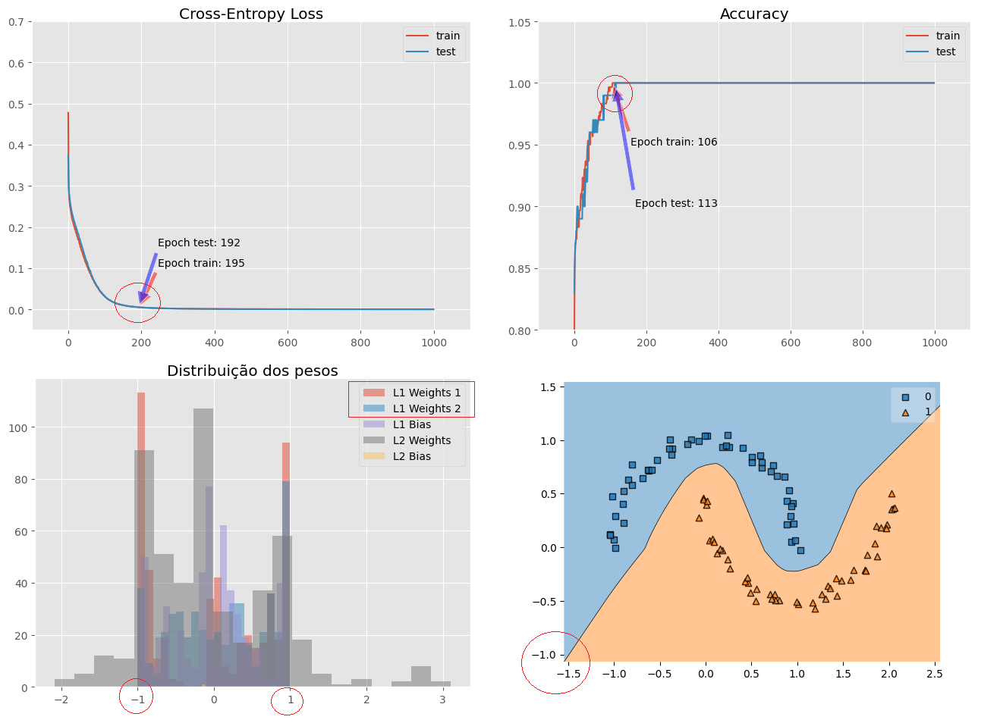

## Com constraints e regularização L2

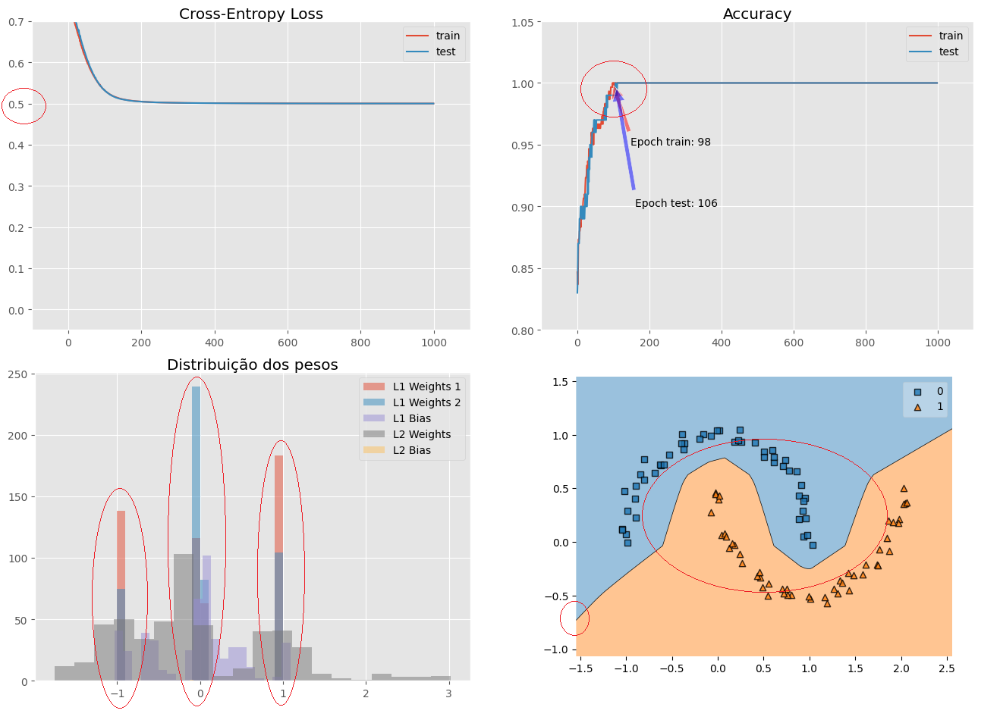

## Com constraints e Dropout (EXTRA)

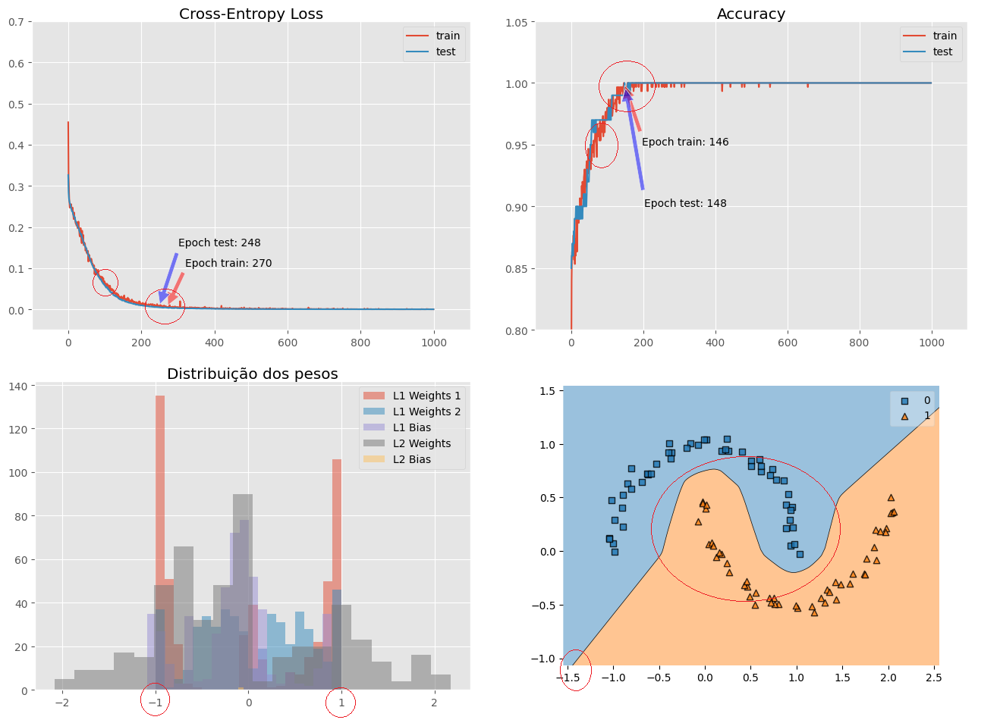

## Com contraints, L2 e Dropout (EXTRA)

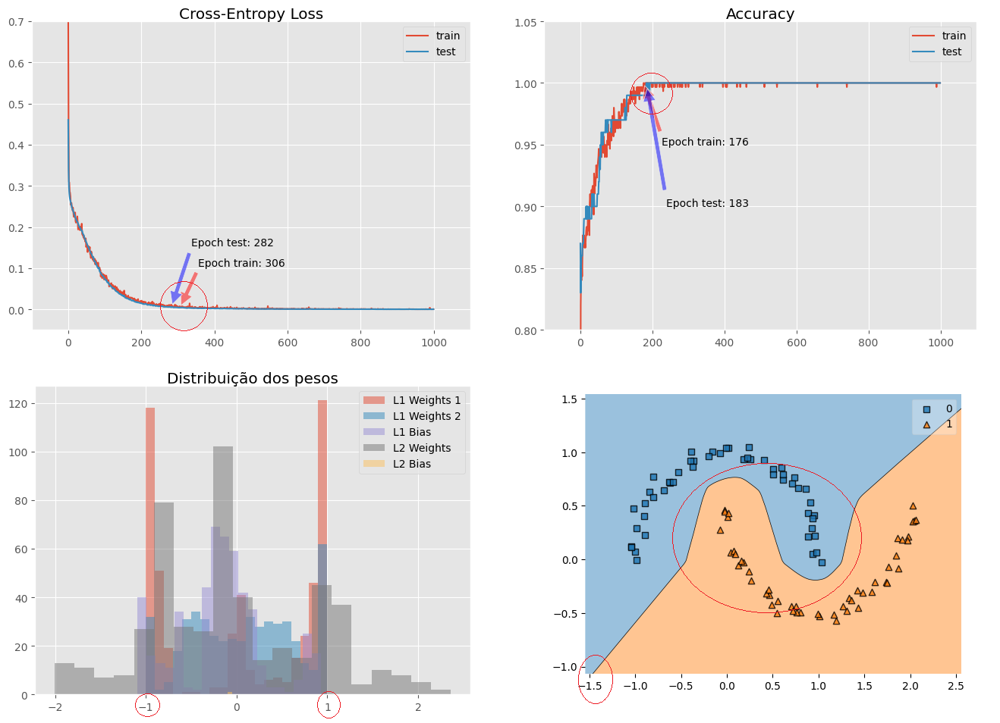

## Com contraints na camada de saída

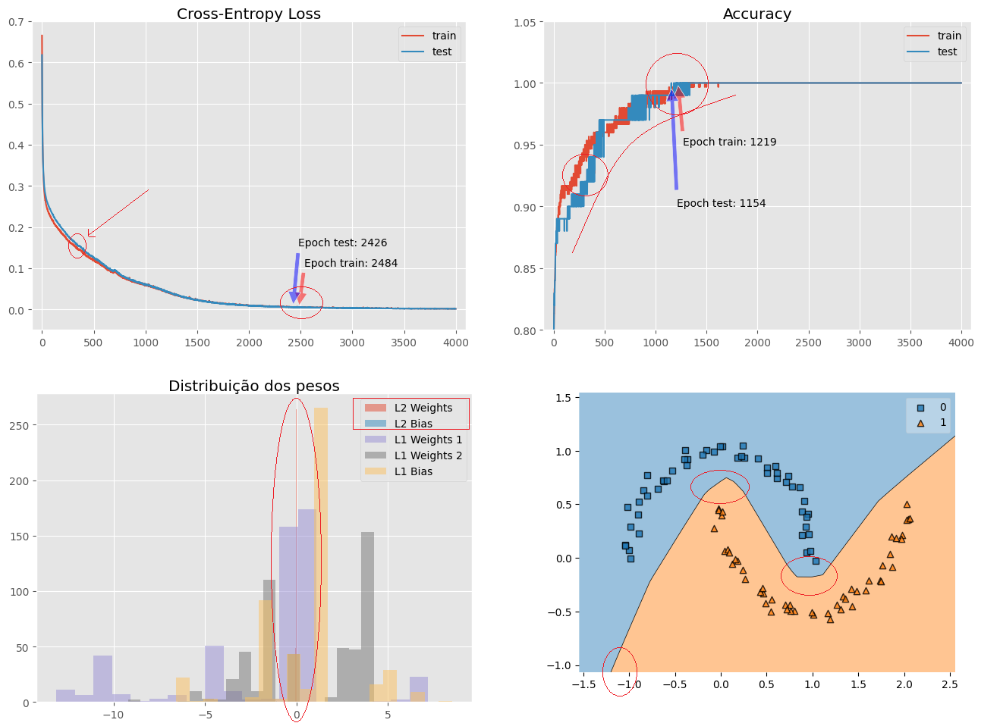

## Com contraints na camada de entrada e saída (EXTRA)

Obs.: Único caso de estudo que não conseguiu 100% de acuracia

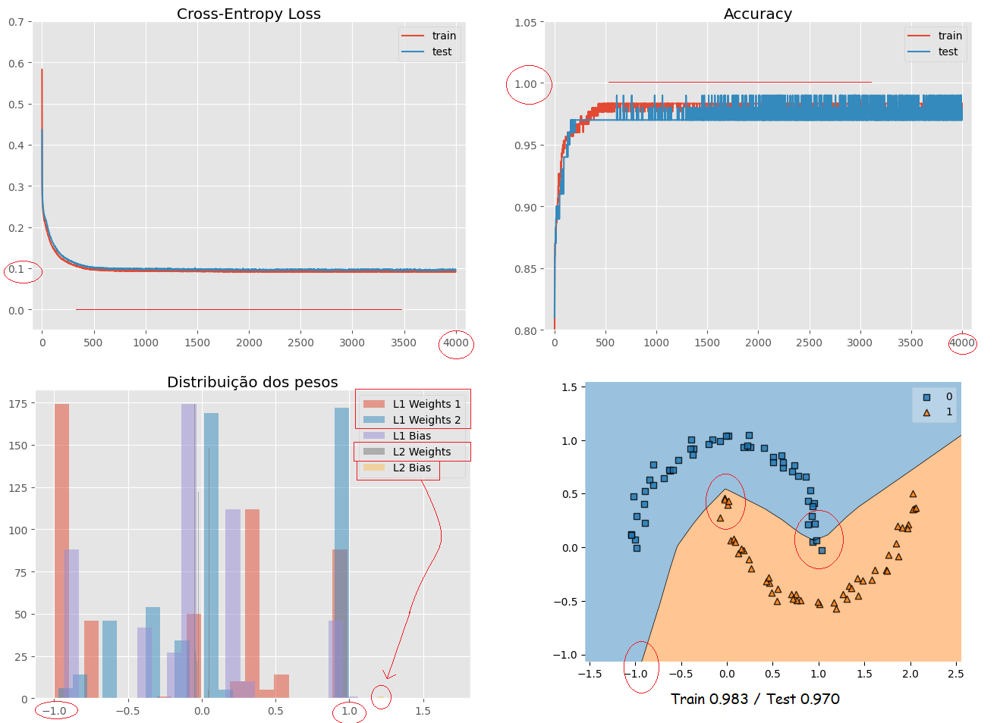

## Com contraints na Bias

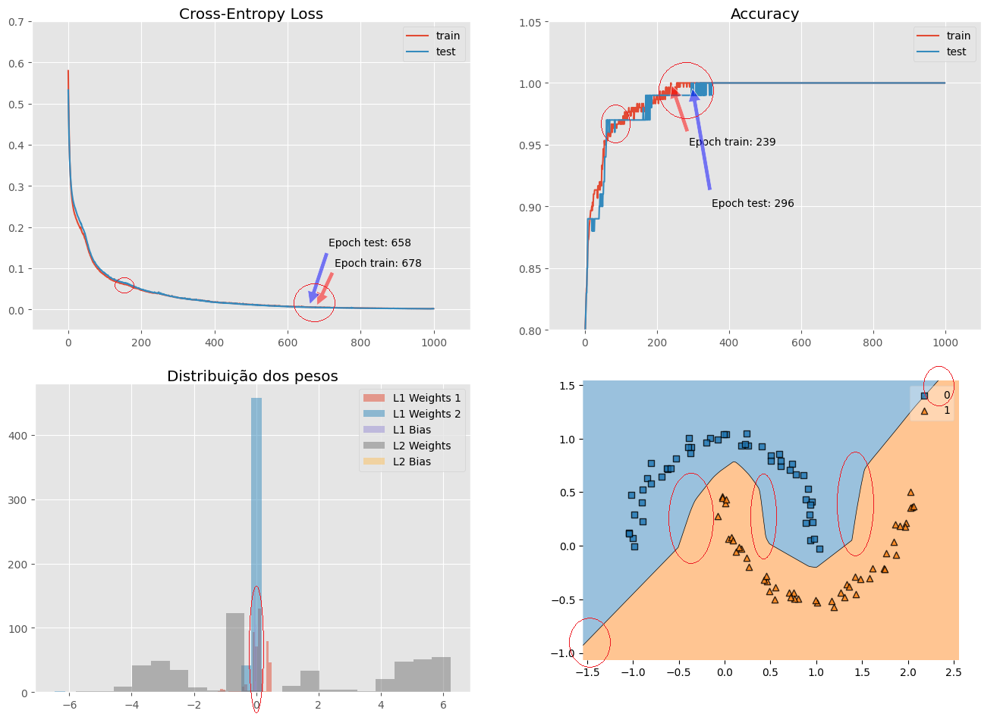

## Com contraints nos pesos e nas bias da camada de entrada (EXTRA)

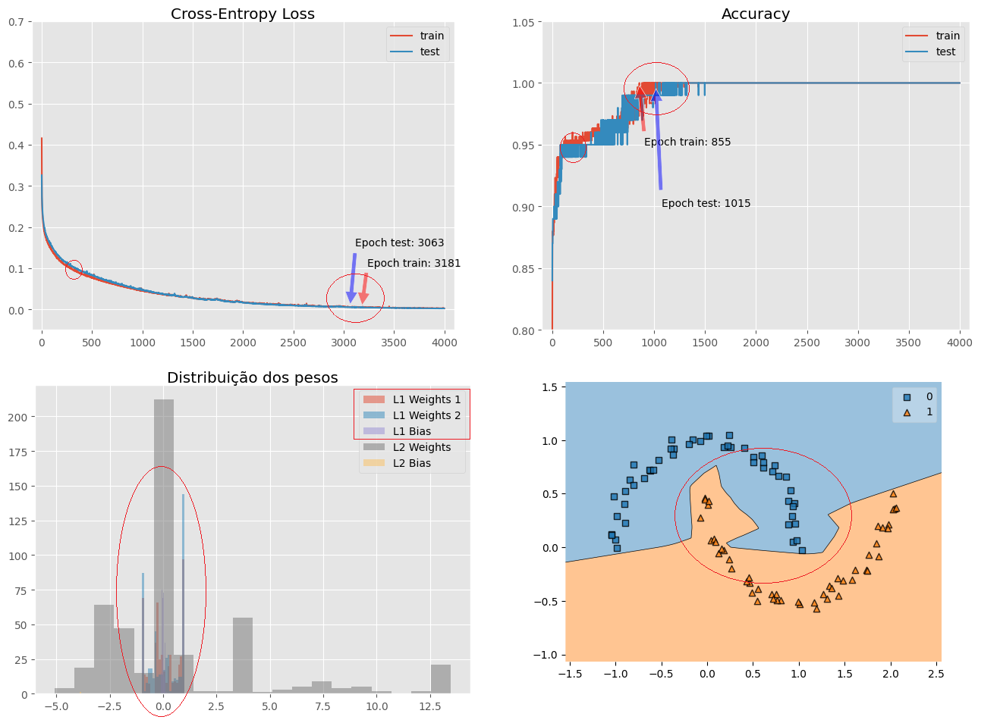

#4.0 Halt training at the right time with early stopping.

O princípio do Early Stopping (ES) é parar o treinameno do modelo no momento em que a variável que está sendo observada apresentar uma piora. Dessa maneira, é possível minimizar as chances de overfitting. Nessa parte do estudo de caso, veremos o ES em três abordagens diferentes:

1.   Using accuracy
2.   Using true validation set
3.   In a regression example

Para todos os exemplos de classificação (1 e 2) estaremos utilizando o dataset make_moons, com 100 samples. Além disso, estará sendo utilizado um modelo com 500 neurônios e (caso o early stopping não atue) 4000 épocas.

##4.1 Functions definition


In [ ]:
def define_model_es(dense):
  """
  Define model that will be used in the classification problem 

  Args:
    dense: int
  
  Returns:
    model
  """
  model = Sequential()
  model.add(Dense(dense, input_dim=2, activation='relu'))
  model.add(Dense(1, activation='sigmoid'))
  model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
  return model

In [ ]:
def define_model_regression():
  model = Sequential()
  model.add(Dense(13, input_dim=13, kernel_initializer='normal', activation='relu'))
  model.add(Dense(1, kernel_initializer='normal'))
  model.compile(loss='mean_squared_error', optimizer='adam')

  return model

In [ ]:
def get_dataset(validation=False):
  """
  Get dataset of moons, from sklearn_datasets, and split in test-train sets. 
  If validation=True, split the data into train-validation-test sets.

  Args:
    validation: boolean
  
  Returns: 
    sets: numpy_array

  """
  x, y = make_moons(n_samples=100, noise=0.2, random_state=1)

  if validation == True:
    n_train = 50
    mark_val_test = 75 
    
    train_x, val_x, test_x = x[:n_train, :], x[n_train:mark_val_test, :], x[mark_val_test:, :]
    train_y, val_y, test_y = y[:n_train], y[n_train:mark_val_test],  y[n_train:mark_val_test]

    return train_x, train_y, val_x, val_y, test_x, test_y
  else:
    n_train = 30 
    train_x, test_x = x[:n_train, :], x[n_train:, :]
    train_y, test_y = y[:n_train], y[n_train:]
    
    return train_x, train_y, test_x, test_y

In [ ]:
def get_dataset_regression():
  """
  Get dataset of boston house prices, from sklearn_datasets, and split in test-train sets. 

  Returns: 
    sets: numpy_array

  """
  x, y = load_boston(return_X_y=True)
  return x, y

In [ ]:
def plot_curves():
  f = plt.figure(figsize=(15,10))

  ax1 = f.add_subplot(211)
  ax1.set_title('Loss')
  ax1.plot(history.history['loss'], label='train')
  ax1.plot(history.history['val_loss'], label='test')
  ax1.legend()
    
  ax2 = f.add_subplot(212)
  ax2.set_title('Accuracy')
  ax2.plot(history.history['accuracy'], label='train')
  ax2.plot(history.history['val_accuracy'], label='test')
  ax2.legend()
  plt.show()

##4.2 Using Accuracy

###4.2.1 ES with Loss


A primeira execução foi realizada ainda monitorando *val_loss* para servir de base comparativa para os demais casos, onde será monitorada a acurácia.

Epoch 01163: early stopping
Train: 1.000, Test: 0.943


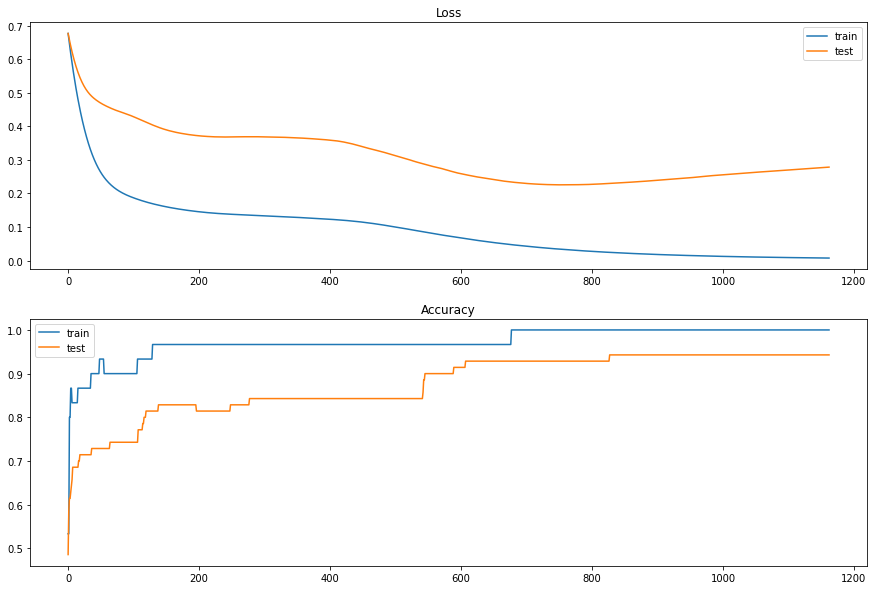

In [ ]:
train_x, train_y, test_x, test_y = get_dataset()

model = define_model_es(500)

# define early stopping and checkpoint callbacks
es = EarlyStopping(monitor='val_loss', verbose=1, patience=400)
mc = ModelCheckpoint('best_model.h5', monitor='val_accuracy',
                     mode='max', verbose=0, save_best_only=True)

history = model.fit(train_x, train_y,
                    validation_data=(test_x, test_y),
                    epochs=4000, verbose=0, callbacks=[es, mc])

# load the saved model - best model saved by modelcheckpoint
saved_model = load_model('best_model.h5')


_, train_acc = saved_model.evaluate(train_x, train_y, verbose=0)
_, test_acc = saved_model.evaluate(test_x, test_y, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

plot_curves()

###4.2.2 ES simple

Epoch 1/4000
1/1 [==============================] - 1s 502ms/step - loss: 0.7012 - accuracy: 0.4667 - val_loss: 0.6837 - val_accuracy: 0.5143
Train: 0.467, Test: 0.514


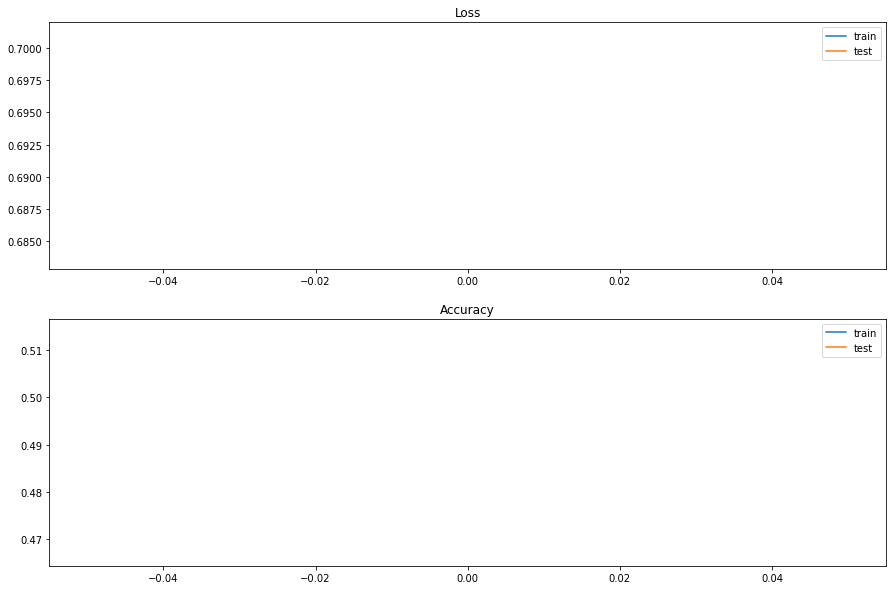

In [ ]:
train_x, train_y, test_x, test_y = get_dataset()

model = define_model_es(500)

# simple early stopping with no patience 
es = EarlyStopping(monitor='val_accuracy', verbose=0)


history = model.fit(train_x, train_y,
                    validation_data=(test_x, test_y),
                    epochs=4000, verbose=1, callbacks=[es])


_, train_acc = model.evaluate(train_x, train_y, verbose=0)
_, test_acc = model.evaluate(test_x, test_y, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

plot_curves()



Primeiro, foi usado a versão mais simples de early stoping, onde o ES recebe apenas dois argumentos: está monitorando a acurácia e tem verbose=0. Aqui, é possível ver que o modelo para logo na primeira época, provavelmente porque na segunda a acurácia já era pior do que a primeira, então o early stopping "entra em ação" e para o treinamento. Essa não é a melhor maneira de treinar esse modelo, já que a acurácia pode melhorar depois da primeira época, mas parou antes. Para evitar esse comportamento, é utilizado o paramêtro patience. 


###4.2.3 ES with patience 

In [ ]:
train_x, train_y, test_x, test_y = get_dataset()

model = define_model_es(500)
possible_patiences = [0, 50, 100, 200, 400, 600, 800]

acc_patience_dict = {}

for value in possible_patiences:
  es = EarlyStopping(monitor='val_accuracy', verbose=0, patience=value)

  history = model.fit(train_x, train_y,
                      validation_data=(test_x, test_y),
                      epochs=4000, verbose=0, callbacks=[es])

  _, train_acc = model.evaluate(train_x, train_y, verbose=0)
  _, test_acc = model.evaluate(test_x, test_y, verbose=0)

  text_evaluate = 'Train: ' + str(round(train_acc,2)) + ' Test: ' + str(round(test_acc,2))
  acc_patience_dict[value] = text_evaluate 


In [ ]:
acc_patience_dict

{0: 'Train: 0.83 Test: 0.76',
 50: 'Train: 0.9 Test: 0.73',
 100: 'Train: 0.97 Test: 0.81',
 200: 'Train: 0.97 Test: 0.84',
 400: 'Train: 1.0 Test: 0.94',
 600: 'Train: 1.0 Test: 0.93',
 800: 'Train: 1.0 Test: 0.91'}



Patience é o parâmetro que define o número de épocas que o modelo vai esperar após detectar uma piora na variável que está sendo monitorada. Não existe um cálculo pré definido para descobrir qual valor é melhor para patience, então o que foi feito foi "rodar" o modelo passando diferentes valores para esse parâmetro e escolher um deles. Nesse caso, depois de patience = 400, a acurácio do treino e do teste permaneceu quase a mesma, então 400 será mantido como melhor caso e é o valor que será aplicado na próxima execução.


Epoch 00403: early stopping
Train: 0.967, Test: 0.843


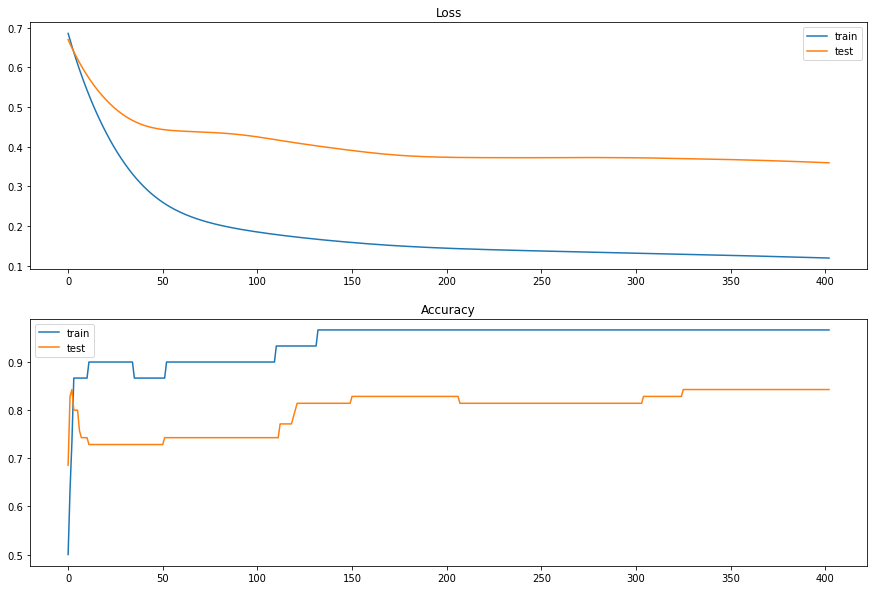

In [ ]:

train_x, train_y, test_x, test_y = get_dataset()

model = define_model_es(500)

es = EarlyStopping(monitor='val_accuracy', verbose=1, patience=400)


history = model.fit(train_x, train_y,
                    validation_data=(test_x, test_y),
                    epochs=4000, verbose=0, callbacks=[es])

_, train_acc = model.evaluate(train_x, train_y, verbose=0)
_, test_acc = model.evaluate(test_x, test_y, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

plot_curves()


###4.2.4 ES with ModelCheckpoint


Epoch 00001: val_accuracy improved from -inf to 0.60000, saving model to best_model.h5

Epoch 00002: val_accuracy improved from 0.60000 to 0.65714, saving model to best_model.h5

Epoch 00003: val_accuracy improved from 0.65714 to 0.68571, saving model to best_model.h5

Epoch 00004: val_accuracy did not improve from 0.68571

Epoch 00005: val_accuracy did not improve from 0.68571

Epoch 00006: val_accuracy did not improve from 0.68571

Epoch 00007: val_accuracy did not improve from 0.68571

Epoch 00008: val_accuracy did not improve from 0.68571

Epoch 00009: val_accuracy did not improve from 0.68571

Epoch 00010: val_accuracy did not improve from 0.68571

Epoch 00011: val_accuracy did not improve from 0.68571

Epoch 00012: val_accuracy did not improve from 0.68571

Epoch 00013: val_accuracy improved from 0.68571 to 0.71429, saving model to best_model.h5

Epoch 00014: val_accuracy did not improve from 0.71429

Epoch 00015: val_accuracy did not improve from 0.71429

Epoch 00016: val_accur

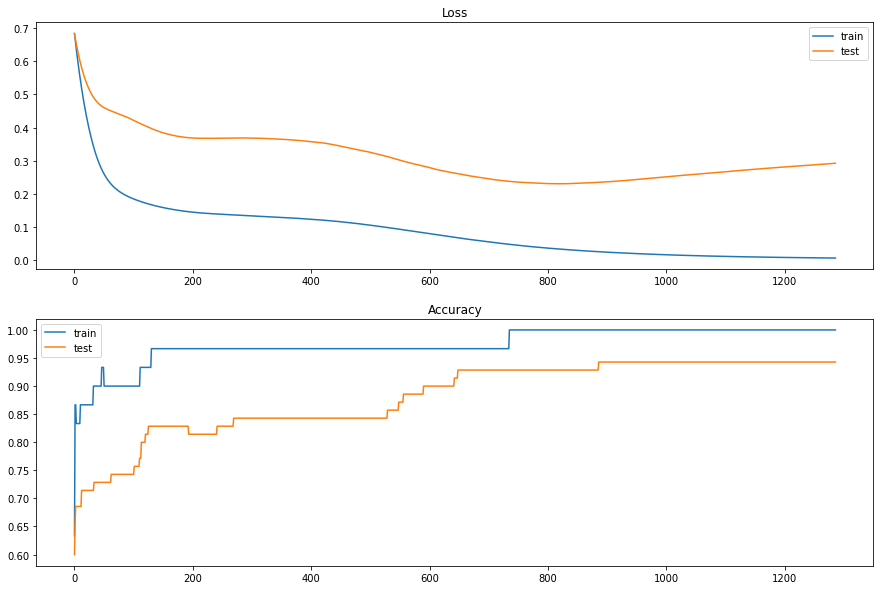

In [ ]:
train_x, train_y, test_x, test_y = get_dataset()

model = define_model_es(500)

es = EarlyStopping(monitor='val_accuracy', verbose=1, patience=400)
mc = ModelCheckpoint('best_model.h5', monitor='val_accuracy', verbose=1, save_best_only=True)


history = model.fit(train_x, train_y,
                    validation_data=(test_x, test_y),
                    epochs=4000, verbose=0, callbacks=[es, mc])

# load the saved model
saved_model = load_model('best_model.h5')

_, train_acc = saved_model.evaluate(train_x, train_y, verbose=0)
_, test_acc = saved_model.evaluate(test_x, test_y, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

plot_curves()

##4.3 Using true validation set

###4.3.1 Monitoring loss

Epoch 01275: early stopping
Train: 0.860, Test: 0.560


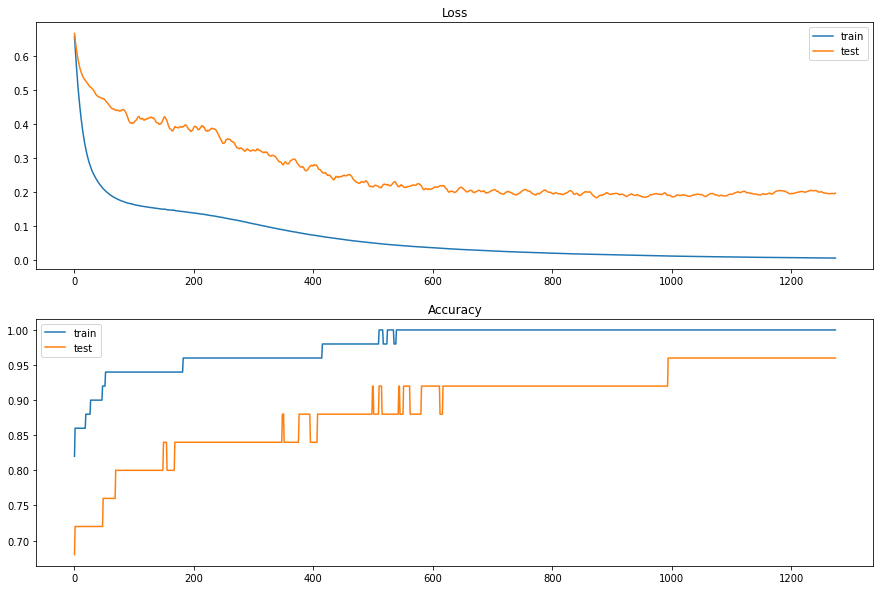

In [ ]:
train_x, train_y, val_x, val_y, test_x, test_y = get_dataset(validation=True)

model = define_model_es(500)

es = EarlyStopping(monitor='val_loss', verbose=1, patience=400)
mc = ModelCheckpoint('best_model.h5', monitor='val_loss',
                     mode='max', verbose=0, save_best_only=True)

history = model.fit(train_x, train_y,
                    validation_data=(val_x, val_y),
                    epochs=4000, verbose=0, callbacks=[es, mc])

saved_model = load_model('best_model.h5')


_, train_acc = saved_model.evaluate(train_x, train_y, verbose=0)
_, test_acc = saved_model.evaluate(test_x, test_y, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

plot_curves()


###4.3.2 Monitoring accuracy

Epoch 01035: early stopping
Train: 1.000, Test: 0.440


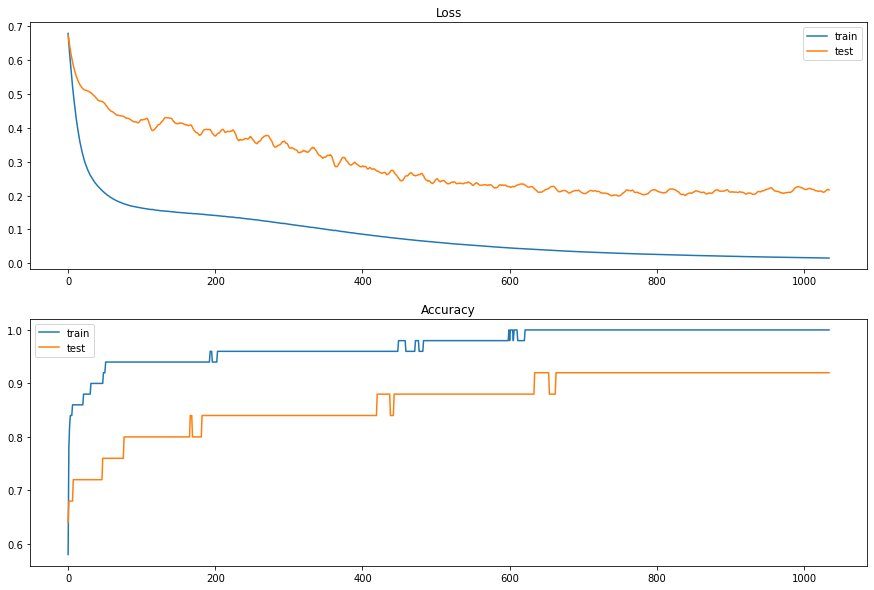

In [ ]:
train_x, train_y, val_x, val_y, test_x, test_y = get_dataset(validation=True)

model = define_model_es(500)

es = EarlyStopping(monitor='val_accuracy', verbose=1, patience=400)
mc = ModelCheckpoint('best_model.h5', monitor='val_accuracy',
                     mode='max', verbose=0, save_best_only=True)

history = model.fit(train_x, train_y,
                    validation_data=(val_x, val_y),
                    epochs=4000, verbose=0, callbacks=[es, mc])

saved_model = load_model('best_model.h5')


_, train_acc = saved_model.evaluate(train_x, train_y, verbose=0)
_, test_acc = saved_model.evaluate(test_x, test_y, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

plot_curves()

## 4.4 Regression example

###4.4.1 Sem ES

In [ ]:
x, y = get_dataset_regression()

estimator = KerasRegressor(build_fn=define_model_regression, epochs=400, batch_size=5, verbose=0)
kfold = KFold(n_splits=10)
results = cross_val_score(estimator, x, y, cv=kfold)
print("Baseline: %.2f (%.2f) MSE" % (results.mean(), results.std()))



Baseline: -33.13 (28.90) MSE


###4.4.2 Com ES

In [ ]:
x, y = get_dataset_regression()

es = EarlyStopping(monitor='loss', verbose=1, patience=20)

estimator = KerasRegressor(build_fn=define_model_regression, epochs=400, batch_size=5, verbose=0, callbacks=[es])
kfold = KFold(n_splits=10)
results = cross_val_score(estimator, x, y, cv=kfold)
print("Baseline: %.2f (%.2f) MSE" % (results.mean(), results.std()))

# Fixing Vanishing Gradients With Relu


#### Class/Models Definitions

In [ ]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_circles
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
import numpy as np

In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = (7.0, 4.0)
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

In [ ]:
class ExtendedTensorBoard(tf.keras.callbacks.TensorBoard):
  def _log_gradients(self, epoch):
    step = tf.cast(epoch, dtype=tf.int64)
    writer = self._train_writer

    with writer.as_default(), tf.GradientTape() as g:
      _x_batch = x_train[:100]
      _y_batch = y_train[:100]

      g.watch(tf.convert_to_tensor(_x_batch))
      _y_pred = self.model(_x_batch)
      loss = self.model.loss(y_true=_y_batch, y_pred=_y_pred[0])
      gradients = g.gradient(loss, self.model.trainable_weights)

      
      for weights, grads in zip(self.model.trainable_weights, gradients):
        tf.summary.histogram(
            weights.name.replace(':', '_')+'_grads', data=grads, step=step)
    
    writer.flush()

  def on_epoch_end(self, epoch, logs=None):  
    super(ExtendedTensorBoard, self).on_epoch_end(epoch, logs=logs)

    if self.histogram_freq and epoch % self.histogram_freq == 0:
      self._log_gradients(epoch)

In [ ]:
def create_sequential(hidden_layers, nodes, activation, kernel_init):
  model = tf.keras.models.Sequential()
  for index in range(hidden_layers):
    if index == 1:
      model.add(tf.keras.layers.Dense(nodes, input_dim=2,activation=activation, kernel_initializer=kernel_init, name='input_layer'))
    else:
      model.add(tf.keras.layers.Dense(nodes,activation=activation, kernel_initializer=kernel_init))
  model.add(tf.keras.layers.Dense(1,activation='sigmoid', name='out_layer'))
  return model

In [ ]:
def plot_history(model_history):
  plt.subplot(211)
  plt.title('Cross-Entropy Loss', pad=-40)
  plt.plot(history.history['loss'], label='train')
  plt.plot(history.history['val_loss'], label='test')
  plt.legend()
  
  plt.subplot(212)
  plt.title('Accuracy', pad=-40)
  plt.plot(history.history['accuracy'], label='train')
  plt.plot(history.history['val_accuracy'], label='test')
  plt.legend()
  plt.tight_layout()
  plt.show()

##### Import Dataset and Train Test Split

In [ ]:
x, y = make_circles(n_samples=1000, noise=0.1, random_state=1)
scaler = MinMaxScaler(feature_range=(-1, 1))
x = scaler.fit_transform(x)
n_train = 500
x_train, x_test = x[:n_train, :], x[n_train:, :]
y_train, y_test = y[:n_train], y[n_train:]

##### Initial Test Model
- 5 hidden Layers.
- 5 nodes per layer.
- Tanh
- Random Uniform Kernel Initializer [0, 1].

Sequential Model Tanh and RandomUniform Kernel Init
Train: 0.614, Test: 0.582


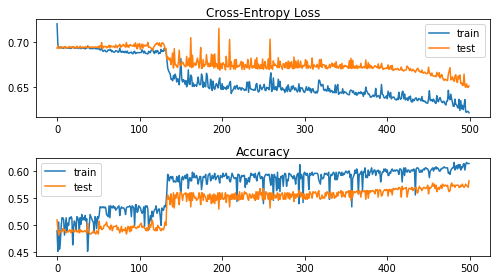

In [ ]:
_model_tanh_rand_uni = create_sequential(hidden_layers=6, 
                                        nodes=5, 
                                        activation='tanh', 
                                        kernel_init=tf.keras.initializers.RandomUniform(minval=0, maxval=1))


_optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
_loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)
_model_tanh_rand_uni.compile(loss=_loss, optimizer=_optimizer, metrics=['accuracy'])
history = _model_tanh_rand_uni.fit(x_train, y_train,
                                   validation_data=(x_test, y_test),
                                   epochs=500, verbose=0)

_, train_acc = _model_tanh_rand_uni.evaluate(x_train, y_train, verbose=0)
_, test_acc = _model_tanh_rand_uni.evaluate(x_test, y_test, verbose=0)
print('Sequential Model Tanh and RandomUniform Kernel Init')
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
plot_history(model_history=history)

#### Weight Initialization
> Update the Deep MLP with **tanh** activation to user **Xavier** uniform wieght initialization and report the results.

Sequential Model Tanh and Xavier Kernel Init
Train: 0.832, Test: 0.820


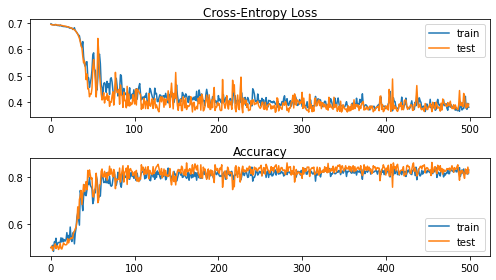

In [ ]:
_model_tanh_xavier = create_sequential(hidden_layers=6, 
                                       nodes=5, 
                                       activation='tanh', 
                                       kernel_init=tf.keras.initializers.GlorotUniform())


_optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
_loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)
_model_tanh_xavier.compile(loss=_loss, optimizer=_optimizer, metrics=['accuracy'])
history = _model_tanh_xavier.fit(x_train, y_train,
                                 validation_data=(x_test, y_test),
                                 epochs=500, verbose=0)

_, train_acc = _model_tanh_xavier.evaluate(x_train, y_train, verbose=0)
_, test_acc = _model_tanh_xavier.evaluate(x_test, y_test, verbose=0)
print('Sequential Model Tanh and Xavier Kernel Init')
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
plot_history(model_history=history)

#### Learning Algorithm
> Update the deep mlp models with tanh activaiton to use an adaptive learning algorithm such as **Adam** and report the results.

Deeper MLP, Tanh and Xavier Uniform Weights
Adam Optimization
Train: 0.824, Test: 0.846


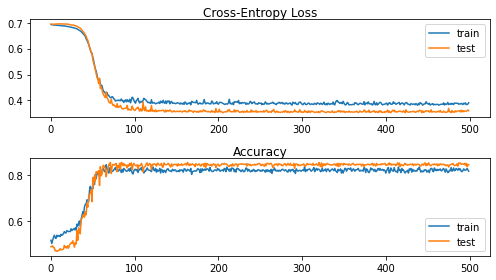

In [ ]:
_model_tanh_adam = create_sequential(hidden_layers=6, 
                                     nodes=5, 
                                     activation='tanh', 
                                     kernel_init=tf.keras.initializers.GlorotUniform())


_optimizer = tf.keras.optimizers.Adam(learning_rate=0.001,beta_1=0.9,beta_2=0.999,epsilon=1e-07,amsgrad=False,name="Adam",)
_loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)
_model_tanh_adam.compile(loss=_loss, optimizer=_optimizer, metrics=['accuracy'])
history = _model_tanh_adam.fit(x_train, y_train,
                               validation_data=(x_test, y_test),
                               epochs=500, verbose=0,)

_, train_acc = _model_tanh_adam.evaluate(x_train, y_train, verbose=0)
_, test_acc = _model_tanh_adam.evaluate(x_test, y_test, verbose=0)
print('Deeper MLP, Tanh and Xavier Uniform Weights')
print('Adam Optimization')
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
plot_history(model_history=history)

#### Gradient Visualization
> Update the **tanh** and **relu** examples to reacord and visualize gradients using **TensorBoard**

In [ ]:
_model_tanh_xavier = create_sequential(hidden_layers=6, 
                                       nodes=5, 
                                       activation='tanh', 
                                       kernel_init=tf.keras.initializers.GlorotUniform())


_optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
_loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)
_model_tanh_xavier.compile(loss=_loss, optimizer=_optimizer, metrics=['accuracy'])
_model_tanh_xavier.fit(x_train, y_train,
                       validation_data=(x_test, y_test),
                       epochs=500, verbose=0,
                       callbacks=[ExtendedTensorBoard(histogram_freq=1, update_freq='batch', log_dir='carvalheira/log/tanh/')])



In [ ]:
%load_ext tensorboard
%tensorboard --logdir='carvalheira/log/tanh/'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
_model_relu_randun = create_sequential(hidden_layers=6, 
                                       nodes=5, 
                                       activation='relu', 
                                       kernel_init=tf.keras.initializers.RandomUniform(minval=0, maxval=1))


_optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
_loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)
_model_relu_randun.compile(loss=_loss, optimizer=_optimizer, metrics=['accuracy'])
_model_relu_randun.fit(x_train, y_train,
                       validation_data=(x_test, y_test),
                       epochs=500, verbose=0,
                       callbacks=[ExtendedTensorBoard(histogram_freq=1, update_freq='batch', log_dir='carvalheira/log/reLU/')])



In [ ]:
%load_ext tensorboard
%tensorboard --logdir='carvalheira/log/reLU/'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

#### Study Model Depth
> Create an experiment using the mlp with tanh activation and report the perfomance of models as the number of hidden layers is sicreased from 1 to 10.

Model Depth 1
Train: 0.822, Test: 0.826


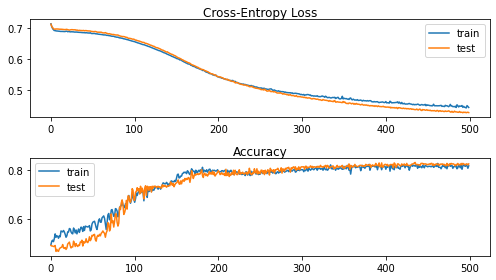

Model Depth 2
Train: 0.826, Test: 0.816


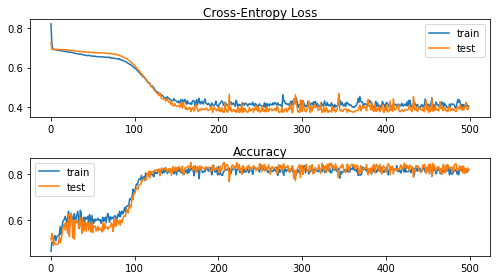

Model Depth 3
Train: 0.824, Test: 0.840


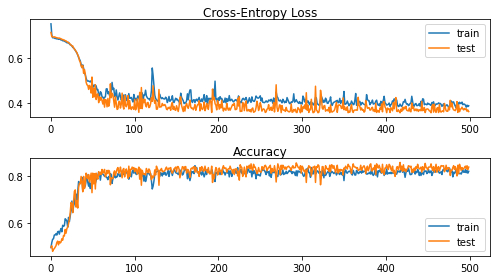

Model Depth 4
Train: 0.844, Test: 0.846


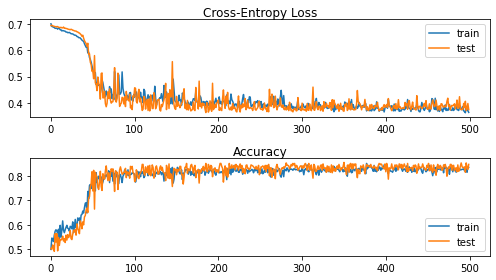

Model Depth 5
Train: 0.858, Test: 0.832


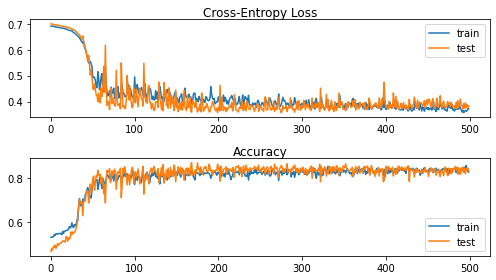

Model Depth 6
Train: 0.834, Test: 0.824


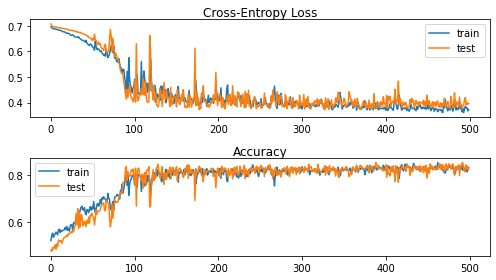

Model Depth 7
Train: 0.840, Test: 0.804


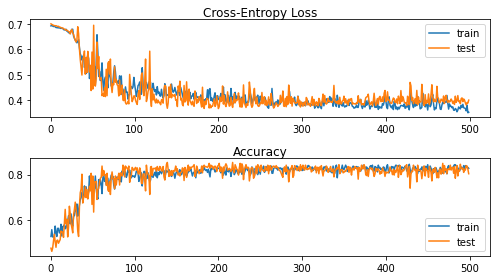

Model Depth 8
Train: 0.822, Test: 0.838


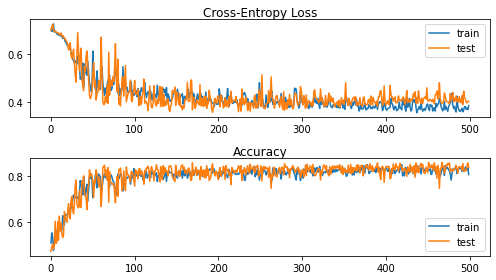

Model Depth 9
Train: 0.826, Test: 0.810


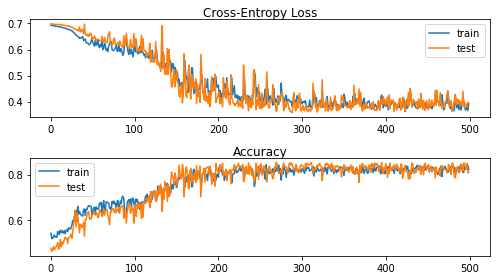

Model Depth 10
Train: 0.826, Test: 0.826


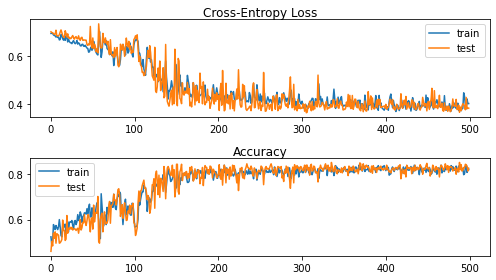

In [ ]:
for layer_range in range(1, 11):
  _model = create_sequential(hidden_layers=layer_range, 
                             nodes=5, 
                             activation='tanh', 
                             kernel_init=tf.keras.initializers.GlorotUniform())


  _optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
  _loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)
  _model.compile(loss=_loss, optimizer=_optimizer, metrics=['accuracy'])
  history = _model.fit(x_train, y_train,
                       validation_data=(x_test, y_test),
                       epochs=500, verbose=0)

  _, train_acc = _model.evaluate(x_train, y_train, verbose=0)
  _, test_acc = _model.evaluate(x_test, y_test, verbose=0)
  print('Model Depth {}'.format(layer_range))
  print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
  plot_history(model_history=history)

#### Increase Breadth
> Increase the number of nodes in the hidden layers of the mlp with tanh activation from 5 to 25 and report performance as number of layers area increased from 1 to 10

Model Breadth 5
Model Depth 1
Train: 0.820, Test: 0.806


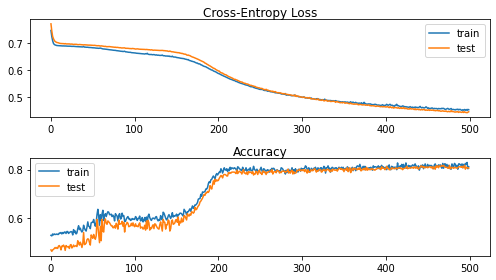

Model Breadth 5
Model Depth 2
Train: 0.838, Test: 0.836


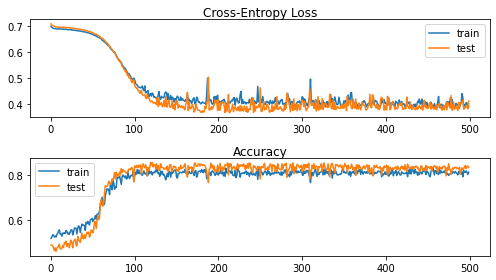

Model Breadth 5
Model Depth 3
Train: 0.818, Test: 0.832


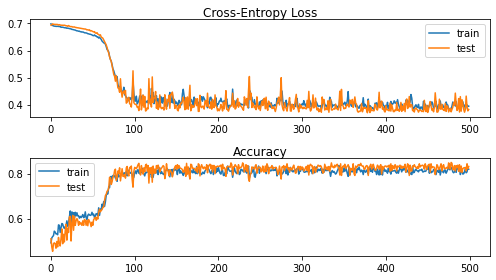

Model Breadth 5
Model Depth 4
Train: 0.818, Test: 0.826


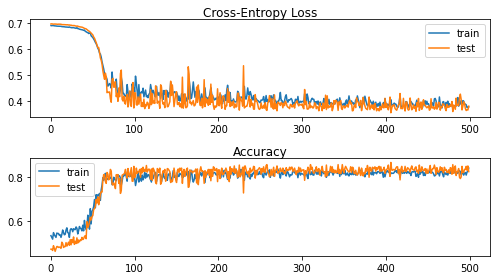

Model Breadth 5
Model Depth 5
Train: 0.840, Test: 0.846


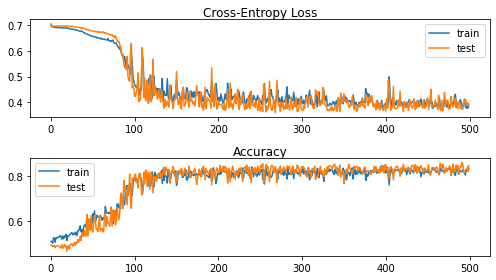

Model Breadth 5
Model Depth 6
Train: 0.806, Test: 0.820


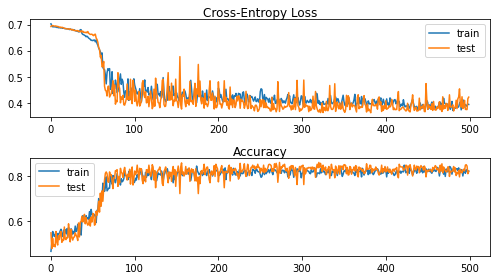

Model Breadth 5
Model Depth 7
Train: 0.836, Test: 0.818


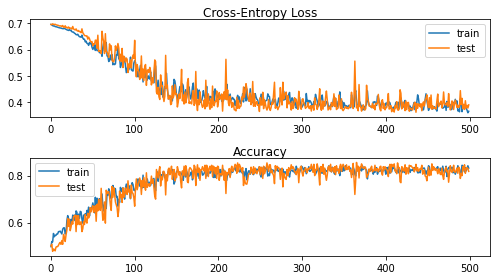

Model Breadth 5
Model Depth 8
Train: 0.832, Test: 0.836


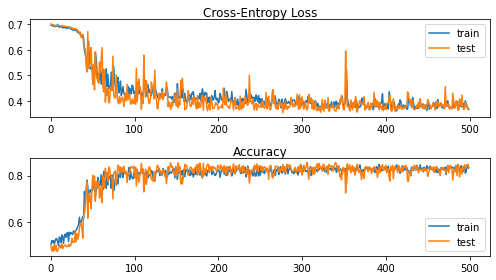

Model Breadth 5
Model Depth 9
Train: 0.836, Test: 0.812


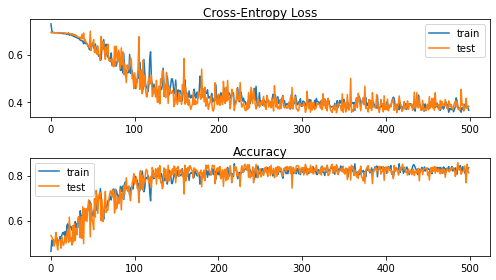

Model Breadth 5
Model Depth 10
Train: 0.826, Test: 0.836


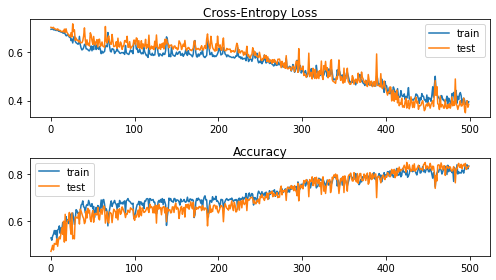

Model Breadth 10
Model Depth 1
Train: 0.814, Test: 0.840


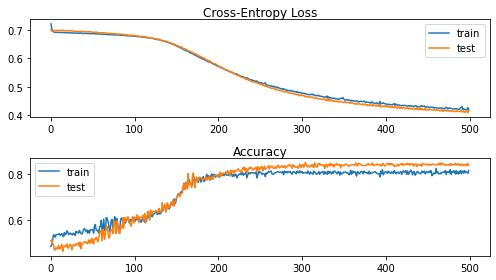

Model Breadth 10
Model Depth 2
Train: 0.828, Test: 0.844


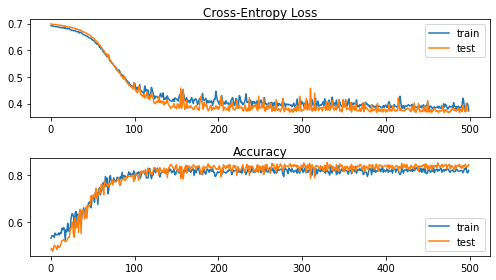

Model Breadth 10
Model Depth 3
Train: 0.812, Test: 0.820


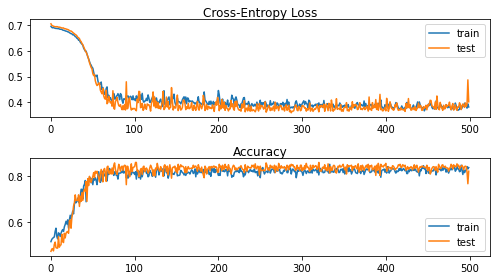

Model Breadth 10
Model Depth 4
Train: 0.832, Test: 0.830


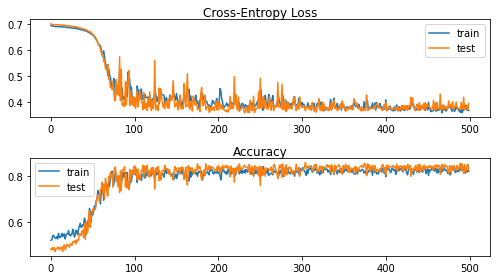

Model Breadth 10
Model Depth 5
Train: 0.844, Test: 0.836


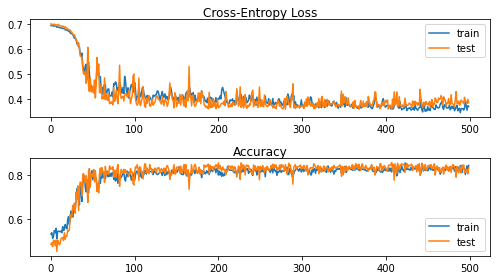

Model Breadth 10
Model Depth 6
Train: 0.844, Test: 0.848


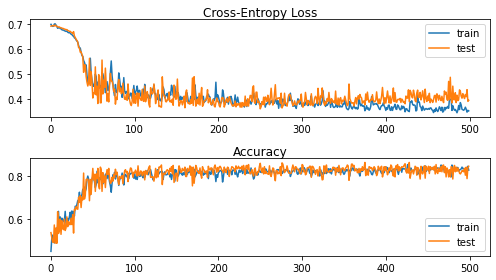

Model Breadth 10
Model Depth 7
Train: 0.818, Test: 0.814


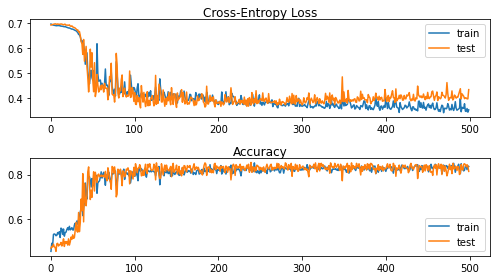

Model Breadth 10
Model Depth 8
Train: 0.834, Test: 0.834


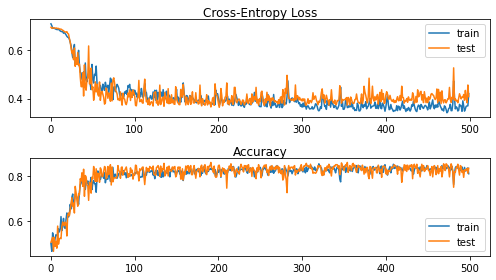

Model Breadth 10
Model Depth 9
Train: 0.836, Test: 0.832


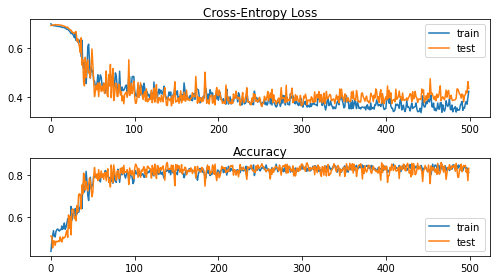

Model Breadth 10
Model Depth 10
Train: 0.854, Test: 0.838


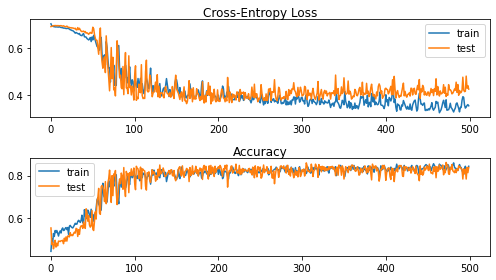

Model Breadth 15
Model Depth 1
Train: 0.826, Test: 0.826


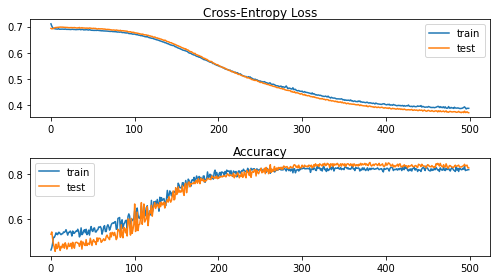

Model Breadth 15
Model Depth 2
Train: 0.832, Test: 0.840


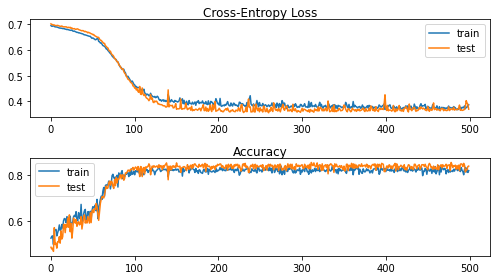

Model Breadth 15
Model Depth 3
Train: 0.830, Test: 0.850


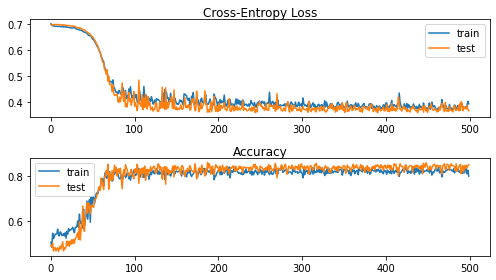

Model Breadth 15
Model Depth 4
Train: 0.834, Test: 0.840


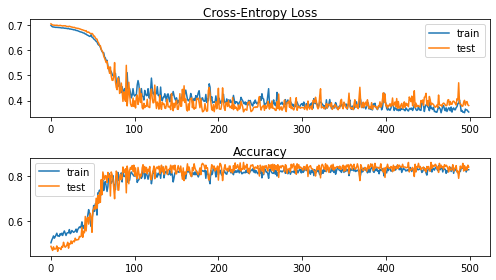

Model Breadth 15
Model Depth 5
Train: 0.848, Test: 0.852


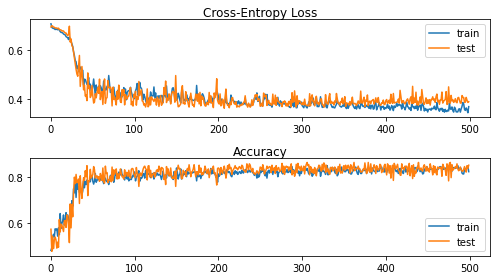

Model Breadth 15
Model Depth 6
Train: 0.846, Test: 0.826


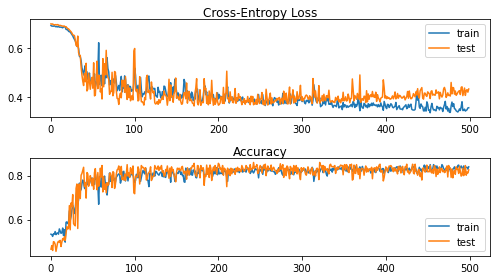

Model Breadth 15
Model Depth 7
Train: 0.844, Test: 0.850


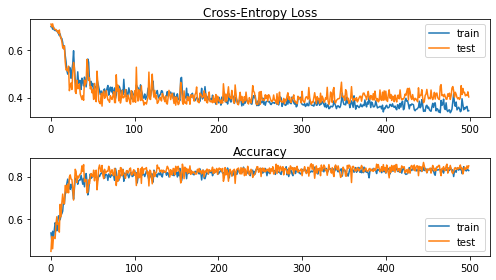

Model Breadth 15
Model Depth 8
Train: 0.830, Test: 0.810


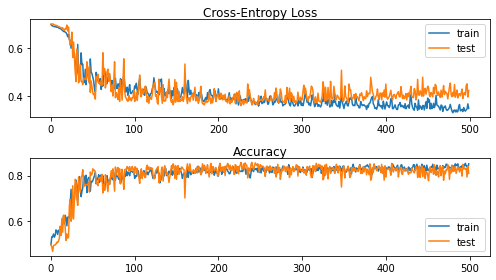

Model Breadth 15
Model Depth 9
Train: 0.842, Test: 0.832


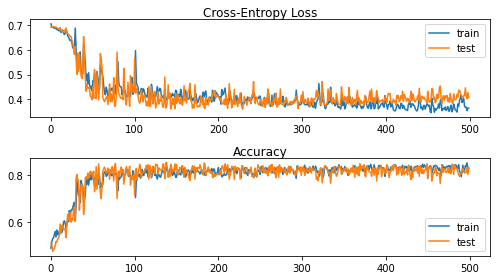

Model Breadth 15
Model Depth 10
Train: 0.848, Test: 0.840


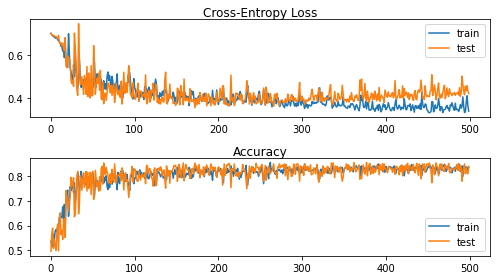

Model Breadth 20
Model Depth 1
Train: 0.834, Test: 0.838


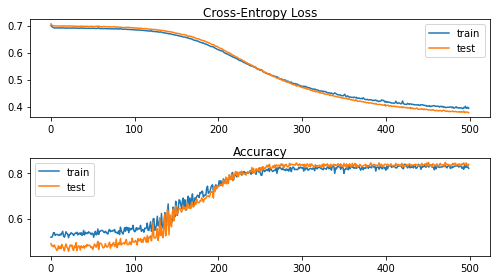

Model Breadth 20
Model Depth 2
Train: 0.834, Test: 0.846


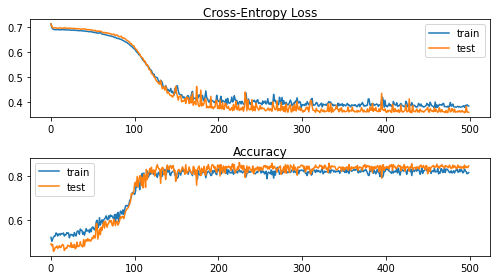

Model Breadth 20
Model Depth 3
Train: 0.834, Test: 0.852


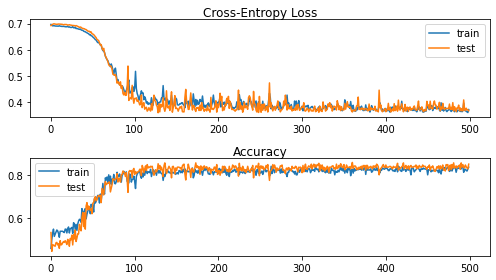

Model Breadth 20
Model Depth 4
Train: 0.838, Test: 0.840


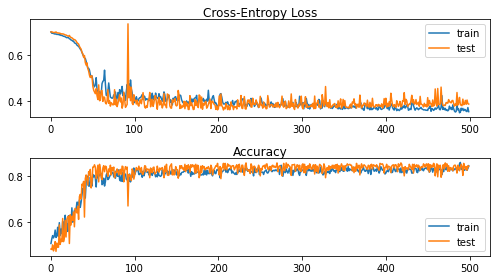

Model Breadth 20
Model Depth 5
Train: 0.834, Test: 0.824


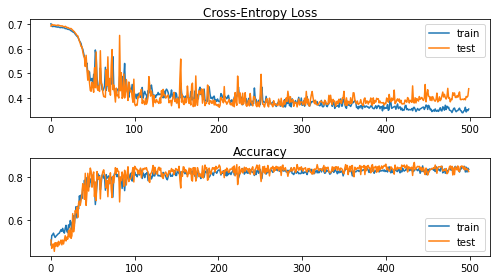

Model Breadth 20
Model Depth 6
Train: 0.838, Test: 0.846


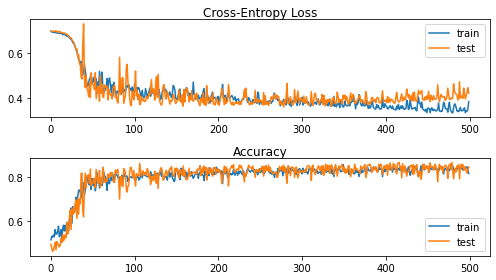

Model Breadth 20
Model Depth 7
Train: 0.850, Test: 0.820


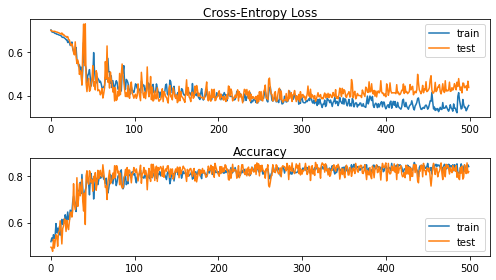

Model Breadth 20
Model Depth 8
Train: 0.838, Test: 0.810


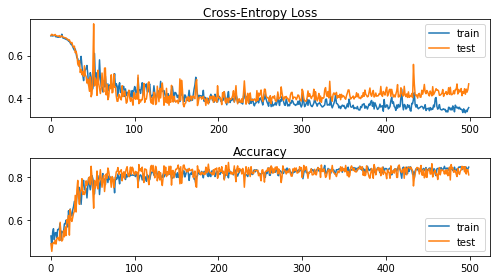

Model Breadth 20
Model Depth 9
Train: 0.838, Test: 0.812


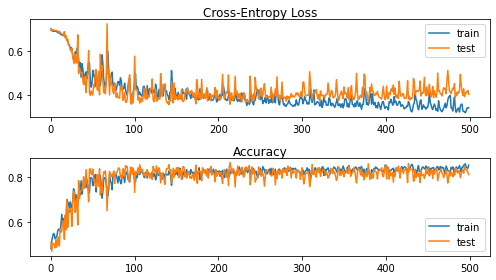

Model Breadth 20
Model Depth 10
Train: 0.856, Test: 0.832


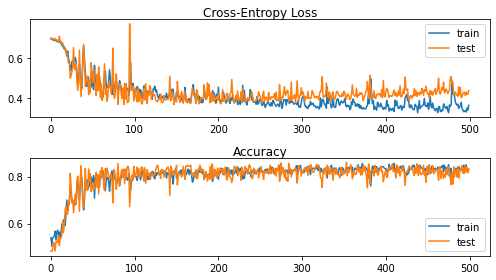

Model Breadth 25
Model Depth 1
Train: 0.818, Test: 0.838


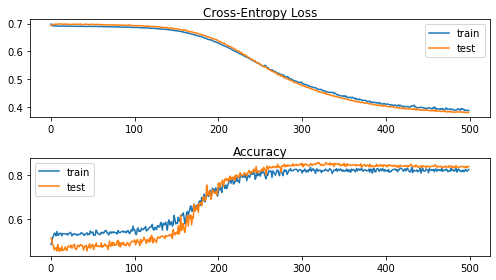

Model Breadth 25
Model Depth 2
Train: 0.820, Test: 0.844


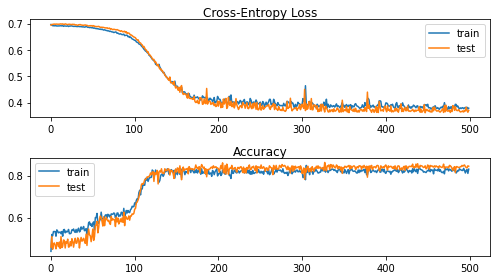

Model Breadth 25
Model Depth 3
Train: 0.826, Test: 0.844


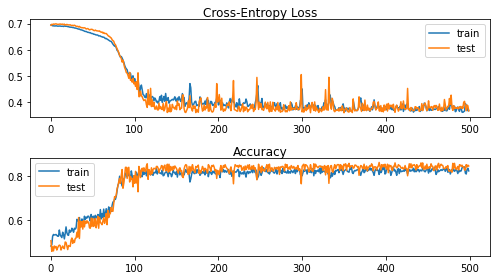

Model Breadth 25
Model Depth 4
Train: 0.838, Test: 0.850


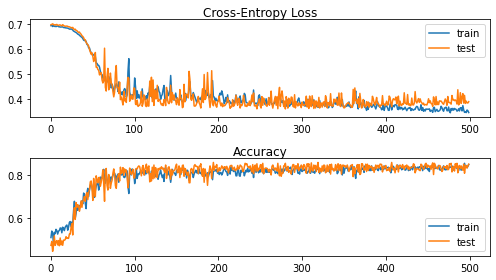

Model Breadth 25
Model Depth 5
Train: 0.836, Test: 0.794


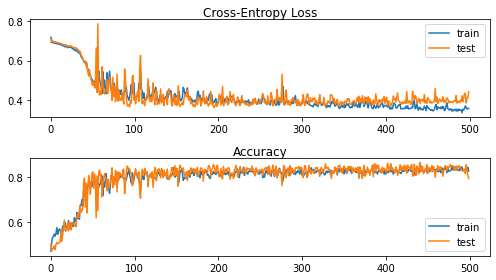

Model Breadth 25
Model Depth 6
Train: 0.848, Test: 0.814


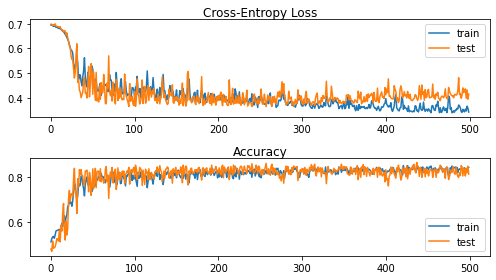

Model Breadth 25
Model Depth 7
Train: 0.852, Test: 0.814


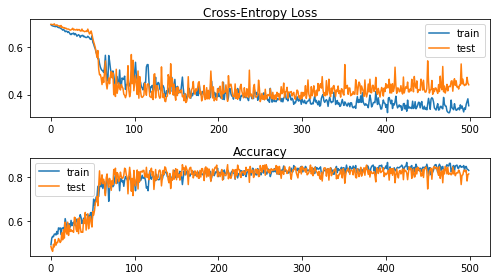

Model Breadth 25
Model Depth 8
Train: 0.834, Test: 0.836


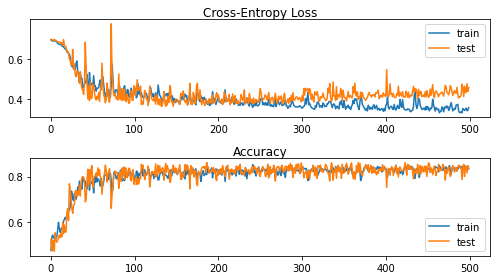

Model Breadth 25
Model Depth 9
Train: 0.862, Test: 0.796


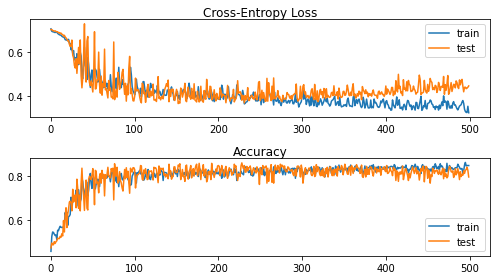

Model Breadth 25
Model Depth 10
Train: 0.852, Test: 0.818


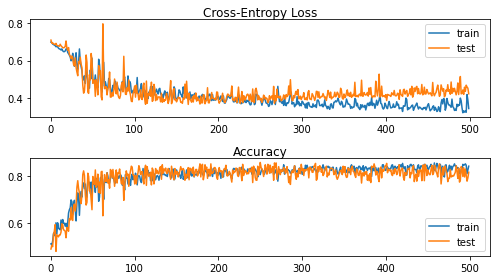

In [ ]:
for breadth_range in range(5, 26, 5):
  for layer_range in range(1, 11):
    _model = create_sequential(hidden_layers=layer_range, 
                              nodes=breadth_range, 
                              activation='tanh', 
                              kernel_init=tf.keras.initializers.GlorotUniform())


    _optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
    _loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)
    _model.compile(loss=_loss, optimizer=_optimizer, metrics=['accuracy'])
    history = _model.fit(x_train, y_train,
                        validation_data=(x_test, y_test),
                        epochs=500, verbose=0)

    _, train_acc = _model.evaluate(x_train, y_train, verbose=0)
    _, test_acc = _model.evaluate(x_test, y_test, verbose=0)
    print('Model Breadth {}'.format(breadth_range))
    print('Model Depth {}'.format(layer_range))
    print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
    plot_history(model_history=history)